In [1]:
# AeroCNN-II
import os
import sys
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer

import datetime
%matplotlib inline

In [2]:
n_kernel=100
l2Regularizer=1e-09
kernel_size1 = 3
kernel_size2 = 3
#kernel_size3 = 5
n_grid = 100
strides1 = 1
strides2 = 2
lr=5e-04
batch_size=20

In [3]:
alpha = np.linspace(-10,20,16).reshape((16,1))

In [4]:
aa = np.zeros((16*133,1))
for i in range(0, 133):
    aa[16*i:16*(i+1), :] = alpha[:,:]

In [5]:
aa = aa.reshape((133*16, 1, 1))

In [6]:
os.chdir('D:\\AeroCNN2Inputs')

In [7]:
origin = "D:\\AeroCNN2Inputs2"
origin_data = "D:\\AirfoilClCdCoordinates_out\\AirfoilClCdCoordinates_out"
origin_poisson = "D:\\CNN_poisson_files\\poisson\\bc2"

In [8]:
folders_orig = os.listdir(origin)
folders = [file for file in folders_orig if file.endswith('.csv')]

In [9]:
image_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        image_df = pd.concat([image_df, data])

In [10]:
image_np = image_df.iloc[:, :].values

In [11]:
image = image_np.reshape((133*16, n_grid, n_grid))

In [12]:
image = 1-image/100

In [13]:
# Laplace/Poisson field
field_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin_poisson + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        field_df = pd.concat([field_df, data], axis=0)

In [14]:
field_np = field_df.iloc[:, :].values

In [15]:
imr = SimpleImputer(missing_values=np.nan, strategy='mean')
imr = imr.fit(field_np)
imputed_field = imr.transform(field_np)

In [16]:
field = imputed_field.reshape((133*16, n_grid, n_grid))

In [17]:
field_nor = (field-np.min(field))/(np.max(field)-np.min(field))

In [18]:
file_name = origin_data + "\\AirfoilIndexList.xlsx"
airfoilName_df = pd.read_excel(file_name)
geometry_orig = airfoilName_df.iloc[:, 1].values

In [19]:
geometry = np.zeros((133*16,1))
geometry = geometry.astype(np.string_)
for i in geometry_orig:
    index_ = np.where(geometry_orig==i)
    for j in range(0,16):
        geometry[16*index_[0]+j,:] = np.asarray(i)

In [20]:
geometry = geometry.reshape((133*16, 1))

In [21]:
x_all, x_test, aa_all, aa_test, geo_all, geo_test, y_all, y_test = train_test_split(image, aa, geometry, field_nor, test_size=0.1, random_state=1)

In [22]:
x_train, x_val, aa_train, aa_val, geo_train, geo_val, y_train, y_val = train_test_split(x_all, aa_all, geo_all, y_all, test_size=0.2, random_state=1)

In [23]:
tf.keras.backend.set_image_data_format('channels_last')

In [24]:
input_image = tf.keras.Input(shape=(n_grid, n_grid, 1))

x_conv1 = tf.keras.layers.Conv2D(n_kernel, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                 activation='relu', padding='same',
                                 kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                 name='Conv2DLayer1')(input_image)
x_1 = tf.keras.layers.MaxPooling2D((2,2))(x_conv1)
x_conv2 = tf.keras.layers.Conv2D(n_kernel*2, (kernel_size2, kernel_size2), strides=(strides1, strides1),
                                 activation='relu', padding='same',
                                 kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                 name='Conv2DLayer2')(x_1)
x_2 = tf.keras.layers.MaxPooling2D((2,2))(x_conv2)

x_deconv1 = tf.keras.layers.Conv2DTranspose(n_kernel*2, (kernel_size2, kernel_size2),
                                            strides=(strides2,strides2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer1')(x_2)
x_deconv2 = tf.keras.layers.Conv2DTranspose(n_kernel, (kernel_size1, kernel_size1),
                                            strides=(strides2,strides2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer2')(x_deconv1)

x_conv_final = tf.keras.layers.Conv2D(1, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                      activation='relu', padding='valid',
                                      kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                      name='Conv2DLayerFinal')(x_deconv2)
x_flat = tf.keras.layers.Flatten()(x_conv_final)
x_ = tf.keras.layers.Dense(units=int((n_grid)**2), activation='linear', name='FCLayer',
                           kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer))(x_flat)

output_data = tf.keras.layers.Reshape((n_grid,n_grid,1))(x_)

# AeroCNN-II/Poisson/BC 2
model = tf.keras.Model(input_image, output_data)

In [25]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100, 100, 1)]     0         
                                                                 
 Conv2DLayer1 (Conv2D)       (None, 100, 100, 100)     1000      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 50, 50, 100)      0         
 )                                                               
                                                                 
 Conv2DLayer2 (Conv2D)       (None, 50, 50, 200)       180200    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 25, 25, 200)      0         
 2D)                                                             
                                                                 
 Conv2DTLayer1 (Conv2DTransp  (None, 50, 50, 200)      360200

In [26]:
#with mirrored_strategy.scope():
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
              loss = tf.keras.losses.MeanSquaredError(),
              metrics=[tf.keras.metrics.RootMeanSquaredError(name="rmse")])

In [27]:
#with mirrored_strategy.scope():
# 끝까지 학습시키고 싶을 땐 ReduceLRONPlateau에서 min_delta를 1e-11로, patience=100,
# EarlyStopping에서 patience를 200으로 설정. 평상시에는(50. 100, 1e-7로.)
# 아예 loss가 1e-6되면 멈추게끔 할 수도?
start = datetime.datetime.now()
history = model.fit(x_train, y_train, epochs=5000, shuffle=True, 
                    validation_data=[x_val, y_val], batch_size=batch_size,
                    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='loss', patience=100,
                                                                min_delta=6e-7,
                                                                restore_best_weights=True,
                                                                verbose=1),
                               tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', factor=0.5,
                                                                    mode='min', patience=50,
                                                                    min_delta=1e-7,
                                                                    min_lr=1e-06,
                                                                    verbose=1)])
end = datetime.datetime.now()

Epoch 1/5000
77/77 [==============================] - 18s 60ms/step - loss: 0.0621 - rmse: 0.2492 - val_loss: 0.0205 - val_rmse: 0.1433 - lr: 5.0000e-04
Epoch 2/5000
77/77 [==============================] - 3s 36ms/step - loss: 0.0192 - rmse: 0.1386 - val_loss: 0.0133 - val_rmse: 0.1153 - lr: 5.0000e-04
Epoch 3/5000
77/77 [==============================] - 3s 37ms/step - loss: 0.0026 - rmse: 0.0510 - val_loss: 3.4442e-04 - val_rmse: 0.0183 - lr: 5.0000e-04
Epoch 4/5000
77/77 [==============================] - 3s 35ms/step - loss: 2.7639e-04 - rmse: 0.0163 - val_loss: 3.3669e-04 - val_rmse: 0.0181 - lr: 5.0000e-04
Epoch 5/5000
77/77 [==============================] - 3s 35ms/step - loss: 2.1535e-04 - rmse: 0.0143 - val_loss: 1.6927e-04 - val_rmse: 0.0126 - lr: 5.0000e-04
Epoch 6/5000
77/77 [==============================] - 3s 35ms/step - loss: 1.9846e-04 - rmse: 0.0137 - val_loss: 1.5188e-04 - val_rmse: 0.0119 - lr: 5.0000e-04
Epoch 7/5000
77/77 [==============================] - 3s 35

77/77 [==============================] - 3s 33ms/step - loss: 1.2684e-04 - rmse: 0.0108 - val_loss: 7.5307e-05 - val_rmse: 0.0081 - lr: 5.0000e-04
Epoch 53/5000
77/77 [==============================] - 3s 33ms/step - loss: 8.5105e-05 - rmse: 0.0086 - val_loss: 1.2339e-04 - val_rmse: 0.0106 - lr: 5.0000e-04
Epoch 54/5000
77/77 [==============================] - 3s 35ms/step - loss: 6.4112e-05 - rmse: 0.0073 - val_loss: 6.0150e-05 - val_rmse: 0.0071 - lr: 5.0000e-04
Epoch 55/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.3813e-05 - rmse: 0.0080 - val_loss: 5.0523e-05 - val_rmse: 0.0063 - lr: 5.0000e-04
Epoch 56/5000
77/77 [==============================] - 3s 33ms/step - loss: 2.7167e-04 - rmse: 0.0162 - val_loss: 1.8127e-04 - val_rmse: 0.0131 - lr: 5.0000e-04
Epoch 57/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.3183e-04 - rmse: 0.0110 - val_loss: 1.2980e-04 - val_rmse: 0.0109 - lr: 5.0000e-04
Epoch 58/5000
77/77 [===========================

Epoch 103/5000
77/77 [==============================] - 3s 33ms/step - loss: 5.0768e-05 - rmse: 0.0064 - val_loss: 7.6203e-05 - val_rmse: 0.0081 - lr: 5.0000e-04
Epoch 104/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.4541e-05 - rmse: 0.0080 - val_loss: 3.2922e-05 - val_rmse: 0.0048 - lr: 5.0000e-04
Epoch 105/5000
77/77 [==============================] - 3s 33ms/step - loss: 5.7221e-05 - rmse: 0.0069 - val_loss: 6.5952e-05 - val_rmse: 0.0075 - lr: 5.0000e-04
Epoch 106/5000
77/77 [==============================] - 3s 35ms/step - loss: 3.6066e-05 - rmse: 0.0051 - val_loss: 4.3940e-05 - val_rmse: 0.0058 - lr: 5.0000e-04
Epoch 107/5000
77/77 [==============================] - 3s 33ms/step - loss: 8.7135e-05 - rmse: 0.0088 - val_loss: 3.9695e-05 - val_rmse: 0.0054 - lr: 5.0000e-04
Epoch 108/5000
77/77 [==============================] - 3s 33ms/step - loss: 5.6437e-05 - rmse: 0.0068 - val_loss: 5.1336e-05 - val_rmse: 0.0064 - lr: 5.0000e-04
Epoch 109/5000
77/77 [======

77/77 [==============================] - 3s 33ms/step - loss: 4.2448e-05 - rmse: 0.0057 - val_loss: 3.1637e-05 - val_rmse: 0.0047 - lr: 5.0000e-04
Epoch 154/5000
77/77 [==============================] - 3s 33ms/step - loss: 4.8920e-05 - rmse: 0.0063 - val_loss: 4.2792e-05 - val_rmse: 0.0058 - lr: 5.0000e-04
Epoch 155/5000
77/77 [==============================] - 2s 32ms/step - loss: 6.3506e-05 - rmse: 0.0073 - val_loss: 3.3845e-05 - val_rmse: 0.0049 - lr: 5.0000e-04
Epoch 156/5000
77/77 [==============================] - 2s 32ms/step - loss: 3.2973e-05 - rmse: 0.0048 - val_loss: 4.1822e-05 - val_rmse: 0.0057 - lr: 5.0000e-04
Epoch 157/5000
77/77 [==============================] - 3s 35ms/step - loss: 2.7389e-05 - rmse: 0.0042 - val_loss: 4.5985e-05 - val_rmse: 0.0060 - lr: 5.0000e-04
Epoch 158/5000
77/77 [==============================] - 2s 32ms/step - loss: 5.9938e-05 - rmse: 0.0071 - val_loss: 9.3290e-05 - val_rmse: 0.0091 - lr: 5.0000e-04
Epoch 159/5000
77/77 [=====================

Epoch 204/5000
77/77 [==============================] - 2s 32ms/step - loss: 2.7481e-05 - rmse: 0.0043 - val_loss: 6.0268e-05 - val_rmse: 0.0071 - lr: 5.0000e-04
Epoch 205/5000
77/77 [==============================] - 2s 32ms/step - loss: 3.7042e-05 - rmse: 0.0053 - val_loss: 3.3225e-05 - val_rmse: 0.0049 - lr: 5.0000e-04
Epoch 206/5000
77/77 [==============================] - 2s 32ms/step - loss: 2.8581e-05 - rmse: 0.0044 - val_loss: 3.3954e-05 - val_rmse: 0.0050 - lr: 5.0000e-04
Epoch 207/5000
77/77 [==============================] - 2s 32ms/step - loss: 2.4183e-05 - rmse: 0.0039 - val_loss: 3.4719e-05 - val_rmse: 0.0050 - lr: 5.0000e-04
Epoch 208/5000
77/77 [==============================] - 2s 32ms/step - loss: 3.0881e-05 - rmse: 0.0047 - val_loss: 5.7740e-05 - val_rmse: 0.0070 - lr: 5.0000e-04
Epoch 209/5000
77/77 [==============================] - 2s 32ms/step - loss: 2.7852e-05 - rmse: 0.0043 - val_loss: 2.0999e-05 - val_rmse: 0.0034 - lr: 5.0000e-04
Epoch 210/5000
77/77 [======

77/77 [==============================] - 3s 33ms/step - loss: 3.1109e-05 - rmse: 0.0047 - val_loss: 2.3439e-05 - val_rmse: 0.0038 - lr: 5.0000e-04
Epoch 255/5000
77/77 [==============================] - 3s 33ms/step - loss: 3.2750e-05 - rmse: 0.0049 - val_loss: 1.3080e-04 - val_rmse: 0.0110 - lr: 5.0000e-04
Epoch 256/5000
77/77 [==============================] - 3s 33ms/step - loss: 3.7405e-05 - rmse: 0.0053 - val_loss: 2.8968e-05 - val_rmse: 0.0045 - lr: 5.0000e-04
Epoch 257/5000
77/77 [==============================] - 3s 33ms/step - loss: 6.2552e-05 - rmse: 0.0073 - val_loss: 3.6537e-05 - val_rmse: 0.0053 - lr: 5.0000e-04
Epoch 258/5000
77/77 [==============================] - 3s 33ms/step - loss: 2.6414e-05 - rmse: 0.0042 - val_loss: 4.6459e-05 - val_rmse: 0.0061 - lr: 5.0000e-04
Epoch 259/5000
77/77 [==============================] - 3s 33ms/step - loss: 2.1200e-05 - rmse: 0.0035 - val_loss: 1.7381e-05 - val_rmse: 0.0029 - lr: 5.0000e-04
Epoch 260/5000
77/77 [=====================

Epoch 305/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.7382e-05 - rmse: 0.0030 - val_loss: 1.6447e-05 - val_rmse: 0.0028 - lr: 5.0000e-04
Epoch 306/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.6137e-05 - rmse: 0.0028 - val_loss: 1.7976e-05 - val_rmse: 0.0031 - lr: 5.0000e-04
Epoch 307/5000
77/77 [==============================] - 3s 33ms/step - loss: 2.0140e-05 - rmse: 0.0034 - val_loss: 3.7727e-05 - val_rmse: 0.0054 - lr: 5.0000e-04
Epoch 308/5000
77/77 [==============================] - 3s 33ms/step - loss: 3.3080e-05 - rmse: 0.0050 - val_loss: 7.5585e-05 - val_rmse: 0.0082 - lr: 5.0000e-04
Epoch 309/5000
77/77 [==============================] - 3s 33ms/step - loss: 2.2765e-05 - rmse: 0.0038 - val_loss: 2.0854e-05 - val_rmse: 0.0035 - lr: 5.0000e-04
Epoch 310/5000
77/77 [==============================] - 3s 33ms/step - loss: 2.4032e-05 - rmse: 0.0040 - val_loss: 6.3301e-05 - val_rmse: 0.0074 - lr: 5.0000e-04
Epoch 311/5000
77/77 [======

77/77 [==============================] - 3s 33ms/step - loss: 1.9667e-05 - rmse: 0.0034 - val_loss: 1.6408e-05 - val_rmse: 0.0029 - lr: 5.0000e-04
Epoch 356/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.5749e-05 - rmse: 0.0028 - val_loss: 3.7086e-05 - val_rmse: 0.0054 - lr: 5.0000e-04
Epoch 357/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.7243e-05 - rmse: 0.0030 - val_loss: 2.0063e-05 - val_rmse: 0.0035 - lr: 5.0000e-04
Epoch 358/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.3812e-05 - rmse: 0.0024 - val_loss: 2.0468e-05 - val_rmse: 0.0035 - lr: 5.0000e-04
Epoch 359/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.6385e-05 - rmse: 0.0029 - val_loss: 1.5609e-05 - val_rmse: 0.0028 - lr: 5.0000e-04
Epoch 360/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.9762e-05 - rmse: 0.0034 - val_loss: 1.6025e-05 - val_rmse: 0.0028 - lr: 5.0000e-04
Epoch 361/5000
77/77 [=====================

Epoch 406/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.0363e-05 - rmse: 0.0017 - val_loss: 2.7160e-05 - val_rmse: 0.0044 - lr: 5.0000e-04
Epoch 407/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.1429e-05 - rmse: 0.0020 - val_loss: 1.4041e-05 - val_rmse: 0.0025 - lr: 5.0000e-04
Epoch 408/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.4529e-05 - rmse: 0.0026 - val_loss: 1.6493e-05 - val_rmse: 0.0030 - lr: 5.0000e-04
Epoch 409/5000
77/77 [==============================] - 2s 32ms/step - loss: 2.2722e-05 - rmse: 0.0039 - val_loss: 2.0738e-05 - val_rmse: 0.0036 - lr: 5.0000e-04
Epoch 410/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.7871e-05 - rmse: 0.0032 - val_loss: 1.4887e-05 - val_rmse: 0.0027 - lr: 5.0000e-04
Epoch 411/5000
77/77 [==============================] - 3s 33ms/step - loss: 2.2872e-05 - rmse: 0.0039 - val_loss: 5.4965e-05 - val_rmse: 0.0069 - lr: 5.0000e-04
Epoch 412/5000
77/77 [======

77/77 [==============================] - 3s 33ms/step - loss: 4.7663e-05 - rmse: 0.0064 - val_loss: 2.3975e-05 - val_rmse: 0.0041 - lr: 5.0000e-04
Epoch 457/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.4856e-05 - rmse: 0.0028 - val_loss: 2.0567e-05 - val_rmse: 0.0037 - lr: 5.0000e-04
Epoch 458/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.1093e-05 - rmse: 0.0020 - val_loss: 1.4252e-05 - val_rmse: 0.0027 - lr: 5.0000e-04
Epoch 459/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.2485e-05 - rmse: 0.0023 - val_loss: 3.1435e-05 - val_rmse: 0.0049 - lr: 5.0000e-04
Epoch 460/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.1679e-05 - rmse: 0.0021 - val_loss: 1.6548e-05 - val_rmse: 0.0031 - lr: 5.0000e-04
Epoch 461/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.0058e-05 - rmse: 0.0017 - val_loss: 1.3886e-05 - val_rmse: 0.0026 - lr: 5.0000e-04
Epoch 462/5000
77/77 [=====================

Epoch 507/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.7338e-05 - rmse: 0.0032 - val_loss: 1.3397e-05 - val_rmse: 0.0026 - lr: 5.0000e-04
Epoch 508/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.2811e-05 - rmse: 0.0025 - val_loss: 3.0314e-05 - val_rmse: 0.0049 - lr: 5.0000e-04
Epoch 509/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.5574e-05 - rmse: 0.0030 - val_loss: 1.9458e-05 - val_rmse: 0.0036 - lr: 5.0000e-04
Epoch 510/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.1628e-05 - rmse: 0.0022 - val_loss: 1.2736e-05 - val_rmse: 0.0024 - lr: 5.0000e-04
Epoch 511/5000
77/77 [==============================] - 3s 33ms/step - loss: 8.7869e-06 - rmse: 0.0014 - val_loss: 1.1970e-05 - val_rmse: 0.0023 - lr: 5.0000e-04
Epoch 512/5000
77/77 [==============================] - 3s 33ms/step - loss: 9.1796e-06 - rmse: 0.0016 - val_loss: 1.2688e-05 - val_rmse: 0.0024 - lr: 5.0000e-04
Epoch 513/5000
77/77 [======

Epoch 556/5000
77/77 [==============================] - 3s 33ms/step - loss: 8.0824e-06 - rmse: 0.0012 - val_loss: 1.2195e-05 - val_rmse: 0.0024 - lr: 2.5000e-04
Epoch 557/5000
77/77 [==============================] - 3s 33ms/step - loss: 8.7423e-06 - rmse: 0.0015 - val_loss: 1.6076e-05 - val_rmse: 0.0031 - lr: 2.5000e-04
Epoch 558/5000
77/77 [==============================] - 3s 33ms/step - loss: 1.1950e-05 - rmse: 0.0023 - val_loss: 1.3208e-05 - val_rmse: 0.0026 - lr: 2.5000e-04
Epoch 559/5000
77/77 [==============================] - 3s 33ms/step - loss: 8.7179e-06 - rmse: 0.0015 - val_loss: 1.2241e-05 - val_rmse: 0.0024 - lr: 2.5000e-04
Epoch 560/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.3162e-06 - rmse: 8.9635e-04 - val_loss: 1.1883e-05 - val_rmse: 0.0023 - lr: 2.5000e-04
Epoch 561/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.2466e-06 - rmse: 8.5925e-04 - val_loss: 1.3255e-05 - val_rmse: 0.0026 - lr: 2.5000e-04
Epoch 562/5000
77/77

Epoch 606/5000
77/77 [==============================] - 3s 33ms/step - loss: 6.9196e-06 - rmse: 7.7864e-04 - val_loss: 1.1260e-05 - val_rmse: 0.0022 - lr: 2.5000e-04
Epoch 607/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.5146e-06 - rmse: 0.0011 - val_loss: 1.1287e-05 - val_rmse: 0.0022 - lr: 2.5000e-04
Epoch 608/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.2968e-06 - rmse: 9.9596e-04 - val_loss: 1.3043e-05 - val_rmse: 0.0026 - lr: 2.5000e-04
Epoch 609/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.9164e-06 - rmse: 0.0013 - val_loss: 1.6510e-05 - val_rmse: 0.0032 - lr: 2.5000e-04
Epoch 610/5000
77/77 [==============================] - 3s 33ms/step - loss: 8.6500e-06 - rmse: 0.0015 - val_loss: 1.2249e-05 - val_rmse: 0.0024 - lr: 2.5000e-04
Epoch 611/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.5653e-06 - rmse: 0.0011 - val_loss: 1.1920e-05 - val_rmse: 0.0024 - lr: 2.5000e-04
Epoch 612/5000
77/77

77/77 [==============================] - 3s 33ms/step - loss: 6.6184e-06 - rmse: 7.1697e-04 - val_loss: 1.0855e-05 - val_rmse: 0.0022 - lr: 2.5000e-04
Epoch 657/5000
77/77 [==============================] - 3s 33ms/step - loss: 6.5076e-06 - rmse: 6.3821e-04 - val_loss: 1.0748e-05 - val_rmse: 0.0022 - lr: 2.5000e-04
Epoch 658/5000
77/77 [==============================] - 3s 33ms/step - loss: 6.4133e-06 - rmse: 5.6322e-04 - val_loss: 1.1218e-05 - val_rmse: 0.0023 - lr: 2.5000e-04
Epoch 659/5000
77/77 [==============================] - 3s 33ms/step - loss: 6.5867e-06 - rmse: 7.0340e-04 - val_loss: 1.1217e-05 - val_rmse: 0.0023 - lr: 2.5000e-04
Epoch 660/5000
77/77 [==============================] - 3s 33ms/step - loss: 6.6388e-06 - rmse: 7.4239e-04 - val_loss: 1.1707e-05 - val_rmse: 0.0024 - lr: 2.5000e-04
Epoch 661/5000
77/77 [==============================] - 3s 33ms/step - loss: 7.0566e-06 - rmse: 9.8640e-04 - val_loss: 1.1403e-05 - val_rmse: 0.0023 - lr: 2.5000e-04
Epoch 662/5000
77/7

In [28]:
time = end - start
print("Training time:", time)

Training time: 0:29:08.737067


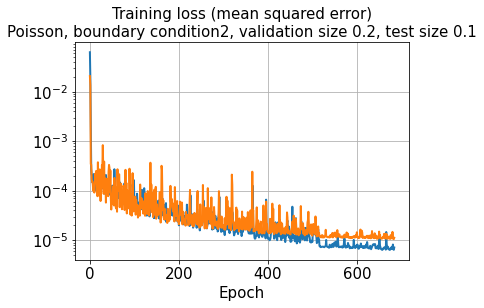

In [29]:
hist = history.history
plt.plot(hist['loss'], lw=2)
plt.plot(hist['val_loss'],lw=2)
plt.title('Training loss (mean squared error)\nPoisson, boundary condition2, validation size 0.2, test size 0.1', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
#plt.ylim([5e-5, 1e-1])
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

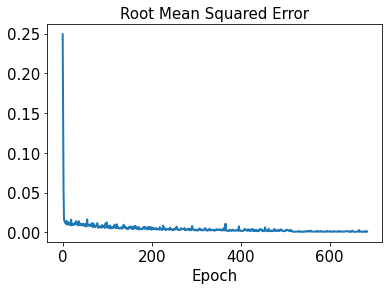

In [30]:
plt.plot(hist['rmse'], lw=2)
plt.title('Root Mean Squared Error', size=15)
plt.xlabel('Epoch', size=15)
plt.tick_params(axis='both', which='major', labelsize=15)
plt.show()

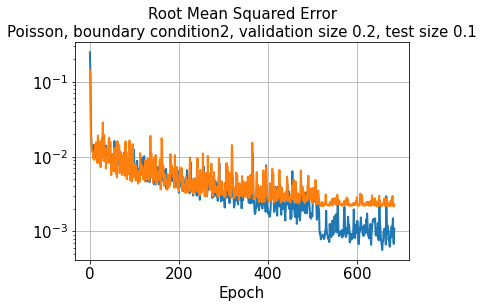

In [31]:
plt.plot(hist['rmse'], lw=2)
plt.plot(hist['val_rmse'], lw=2)
plt.title('Root Mean Squared Error\nPoisson, boundary condition2, validation size 0.2, test size 0.1', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

In [32]:
#with mirrored_strategy.scope():
test_results = model.evaluate(x_train)

48/48 [==============================] - 0s 3ms/step - loss: 6.4016e-06 - rmse: 0.0000e+00


In [33]:
#with mirrored_strategy.scope():
decoded_train = model.predict(x_train)

48/48 [==============================] - 1s 12ms/step


In [34]:
decoded_val = model.predict(x_val)

12/12 [==============================] - 0s 21ms/step


In [35]:
#with mirrored_strategy.scope():
decoded_test = model.predict(x_test)

7/7 [==============================] - 0s 26ms/step


In [37]:
error_train_abs = np.abs(decoded_train - y_train.reshape((1532,100,100,1)))

In [38]:
error_val_abs = np.abs(decoded_val - y_val.reshape((-1, 100,100,1)))

In [39]:
error_test_abs = np.abs(decoded_test - y_test.reshape((-1, 100,100,1)))

In [40]:
os.chdir("D:\\TrainedModels\\20221030")
model.save('Poisson_bc2_100kernel_2by2MaxPooling_2CNNlayer_randomSplit_valSize0.2testSize0.1.h5',
           overwrite=True, include_optimizer=True, save_format='h5')

In [42]:
l2_error_train = np.sqrt(np.sum((decoded_train - y_train.reshape((-1, 100,100,1)))**2) / np.sum(y_train.reshape((-1, 100,100,1))**2))
print(l2_error_train)

0.0010157207474546617


In [43]:
l2_error_val = np.sqrt(np.sum((decoded_val - y_val.reshape((-1, 100,100,1)))**2) / np.sum(y_val.reshape((-1, 100,100,1))**2))
print(l2_error_val)

0.003270103080050689


In [44]:
l2_error_test = np.sqrt(np.sum((decoded_test - y_test.reshape((-1, 100,100,1)))**2) / np.sum(y_test.reshape((-1, 100,100,1))**2))
print(l2_error_test)

0.0030919464481174532


In [45]:
l2_error_train_list = []
for i in range(0, len(aa_train)):
    l2_error_train_data = np.sqrt(np.sum((decoded_train[i] - y_train.reshape((-1, 100,100,1))[i])**2) / np.sum(y_train.reshape((-1, 100,100,1))[i]**2))
    l2_error_train_list.append(l2_error_train_data)
#print(l2_error_train_list)

In [47]:
l2_error_val_list = []
for i in range(0, len(aa_val)):
    l2_error_val_data = np.sqrt(np.sum((decoded_val[i] - y_val.reshape((-1, 100,100,1))[i])**2) / np.sum(y_val.reshape((-1, 100,100,1))[i]**2))
    l2_error_val_list.append(l2_error_val_data)

In [48]:
l2_error_test_list = []
for i in range(0, len(aa_test)):
    l2_error_test_data = np.sqrt(np.sum((decoded_test[i] - y_test.reshape((-1, 100,100,1))[i])**2) / np.sum(y_test.reshape((-1, 100,100,1))[i]**2))
    l2_error_test_list.append(l2_error_test_data)
#print(l2_error_test_list)

In [49]:
os.chdir("D:\\CNN_poisson_files\\images\\20221030\\Randomsplit0.70.20.1")

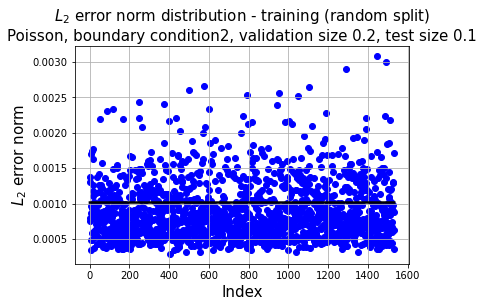

In [50]:
plt.plot(np.linspace(1, aa_train.shape[0], aa_train.shape[0]),
         l2_error_train*np.ones(aa_train.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_train.shape[0], aa_train.shape[0]), l2_error_train_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - training (random split)\nPoisson, boundary condition2, validation size 0.2, test size 0.1',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(training).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

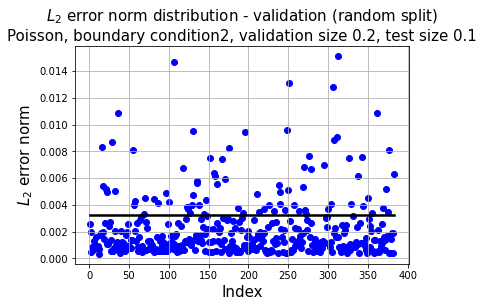

In [51]:
plt.plot(np.linspace(1, aa_val.shape[0], aa_val.shape[0]),
         l2_error_val*np.ones(aa_val.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_val.shape[0], aa_val.shape[0]), l2_error_val_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - validation (random split)\nPoisson, boundary condition2, validation size 0.2, test size 0.1',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(validation).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

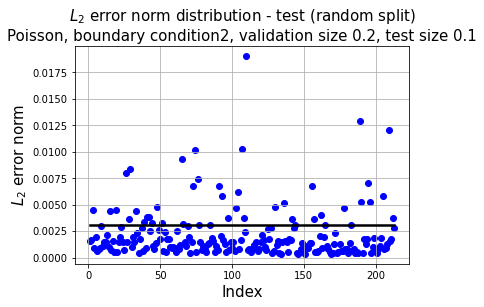

In [52]:
plt.plot(np.linspace(1, aa_test.shape[0], aa_test.shape[0]),
         l2_error_test*np.ones(aa_test.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_test.shape[0], aa_test.shape[0]), l2_error_test_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - test (random split)\nPoisson, boundary condition2, validation size 0.2, test size 0.1',
          fontsize=15)
plt.grid()
save_test_name = "20221030L2ErrorDistribution_Poisson_bc2(test).jpg"
plt.savefig(save_test_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

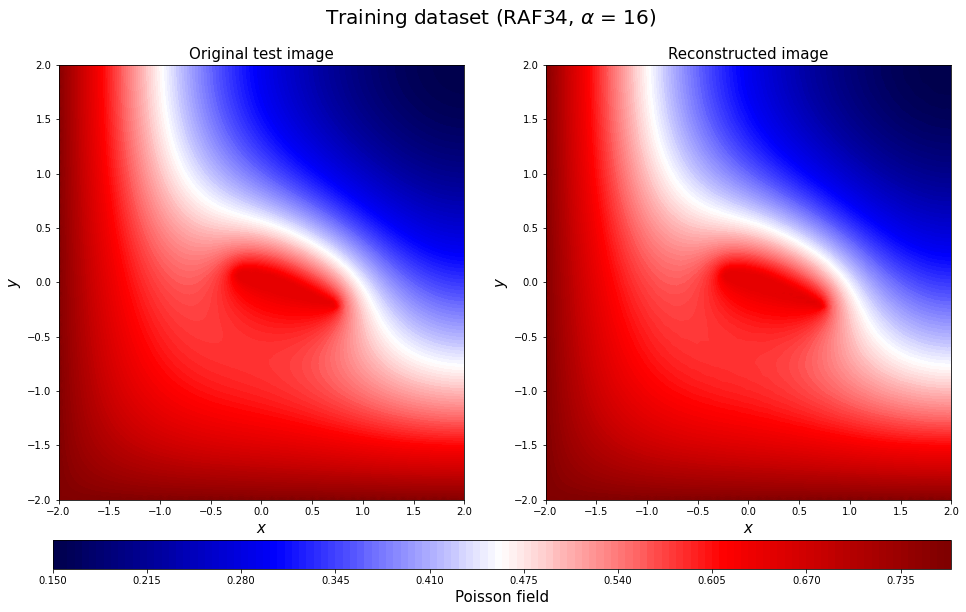

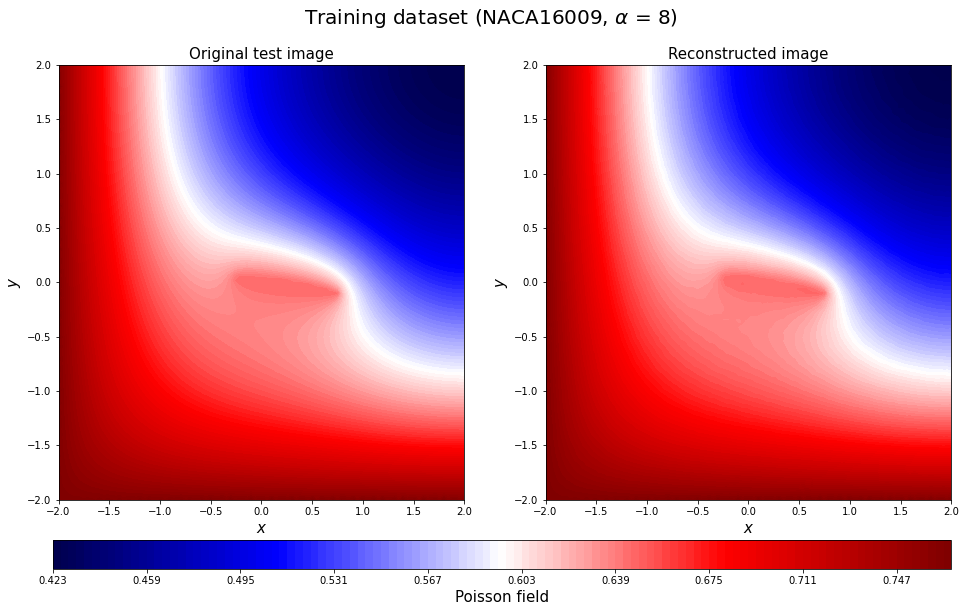

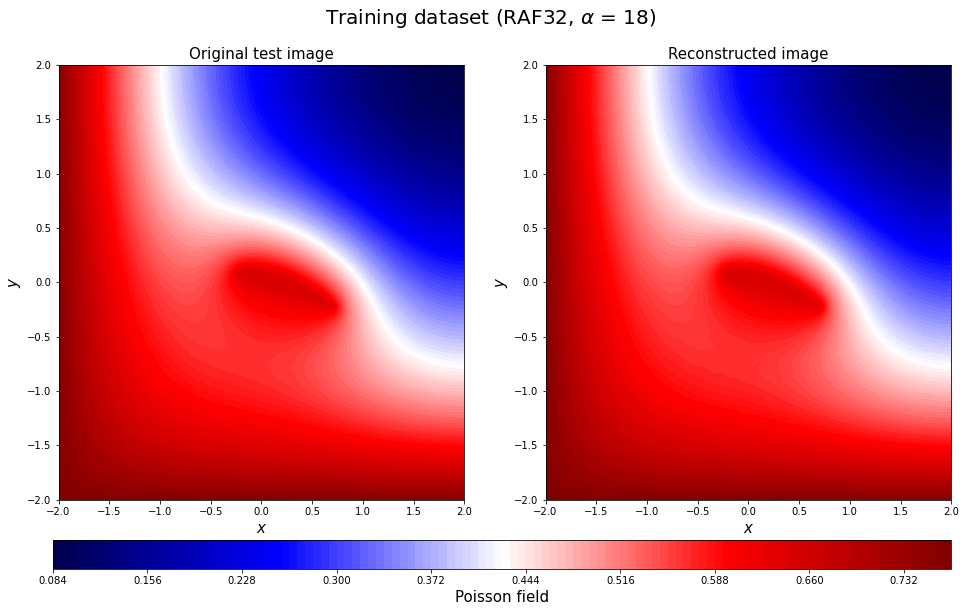

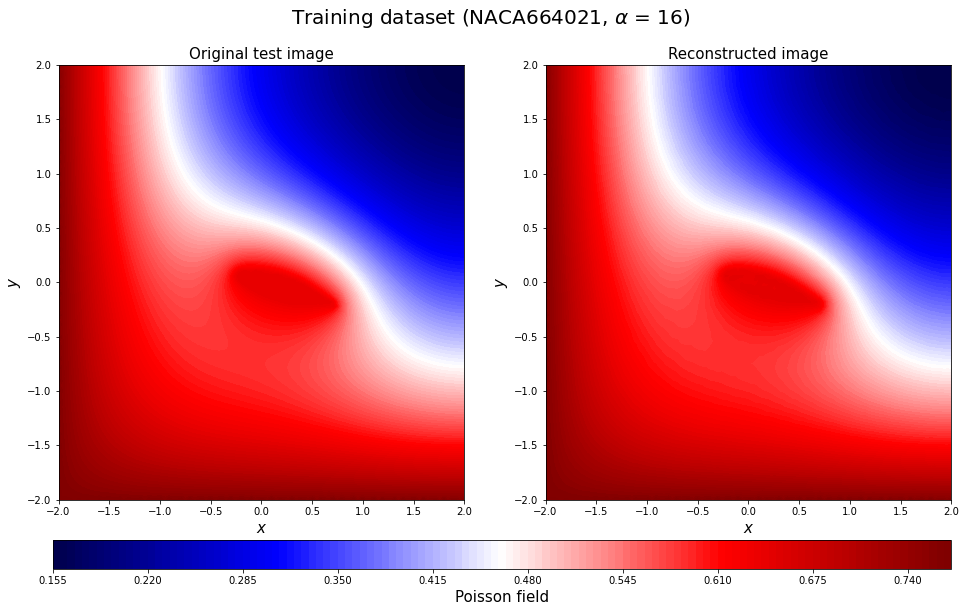

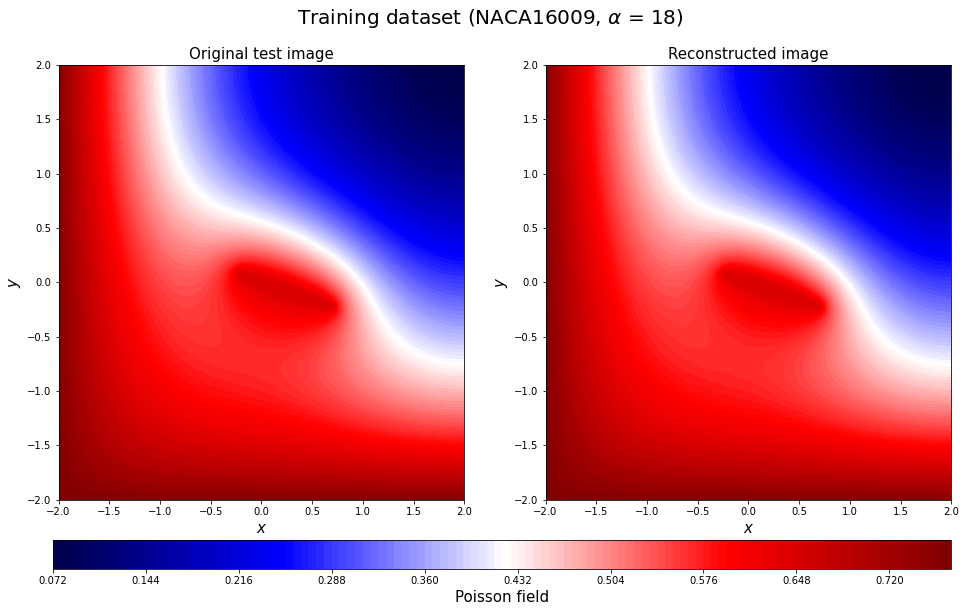

...

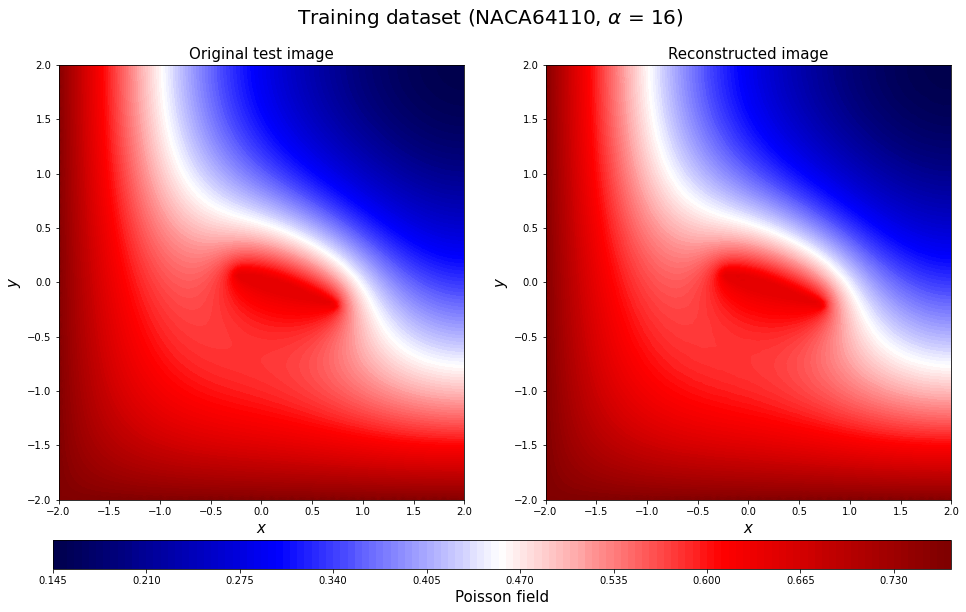

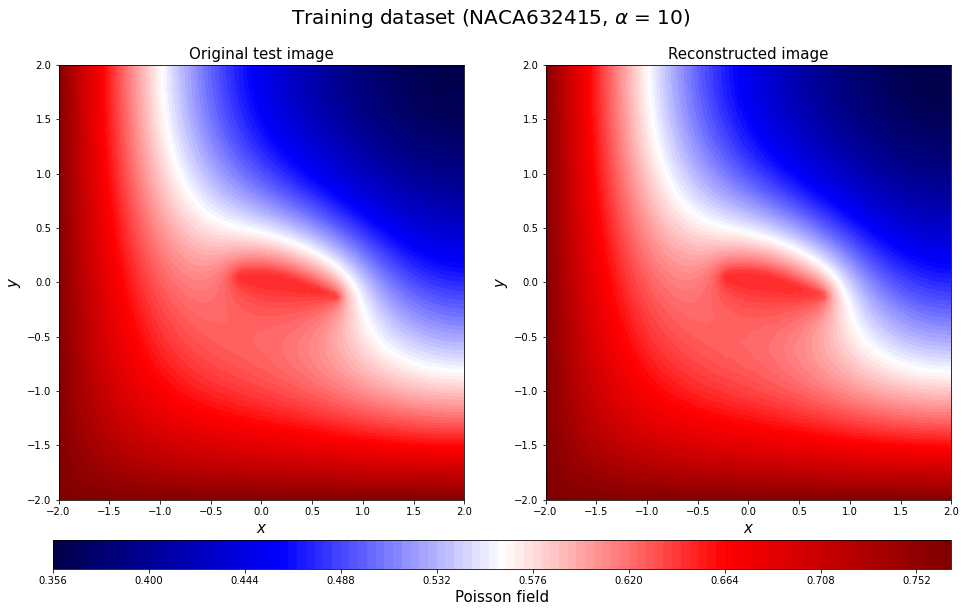

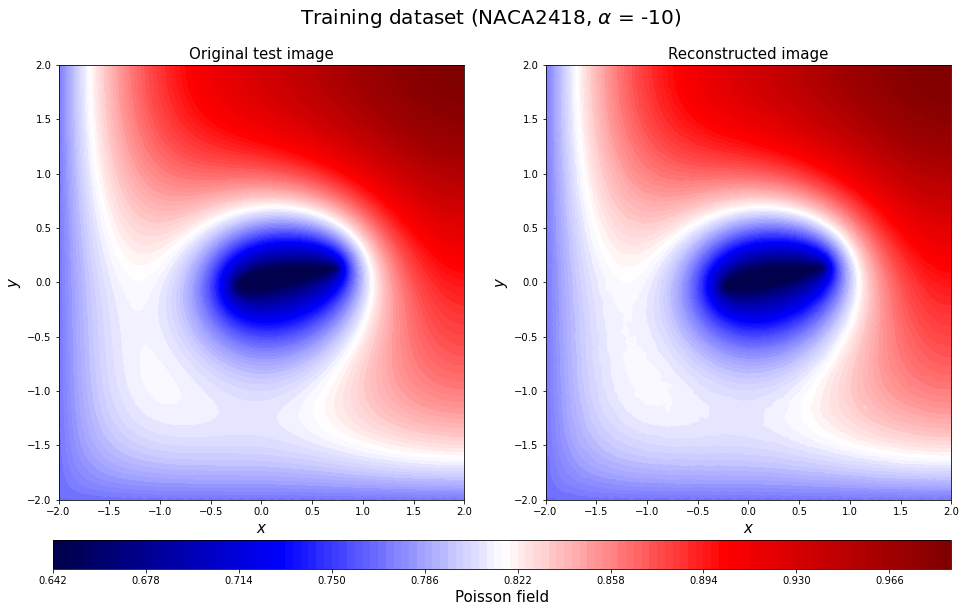

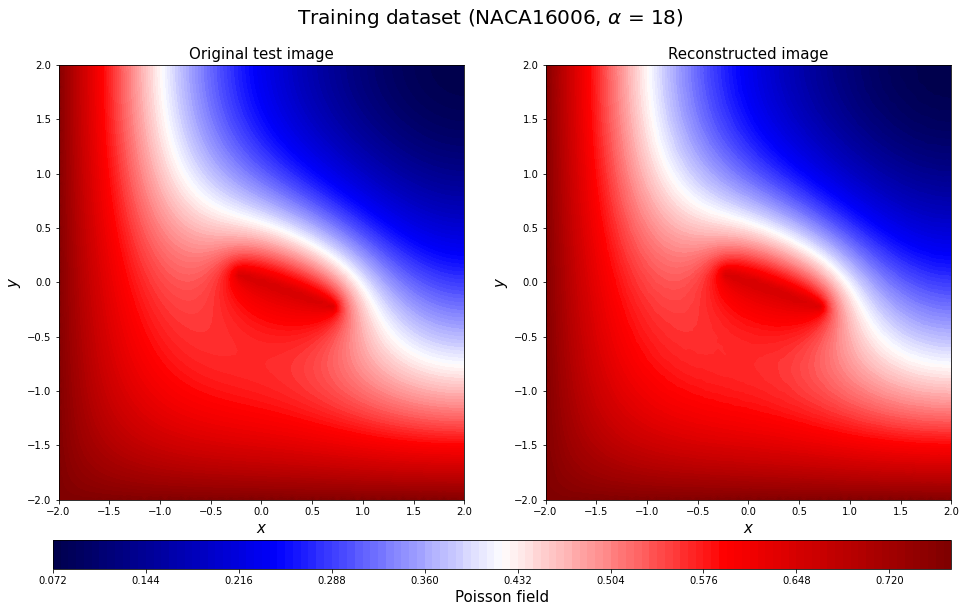

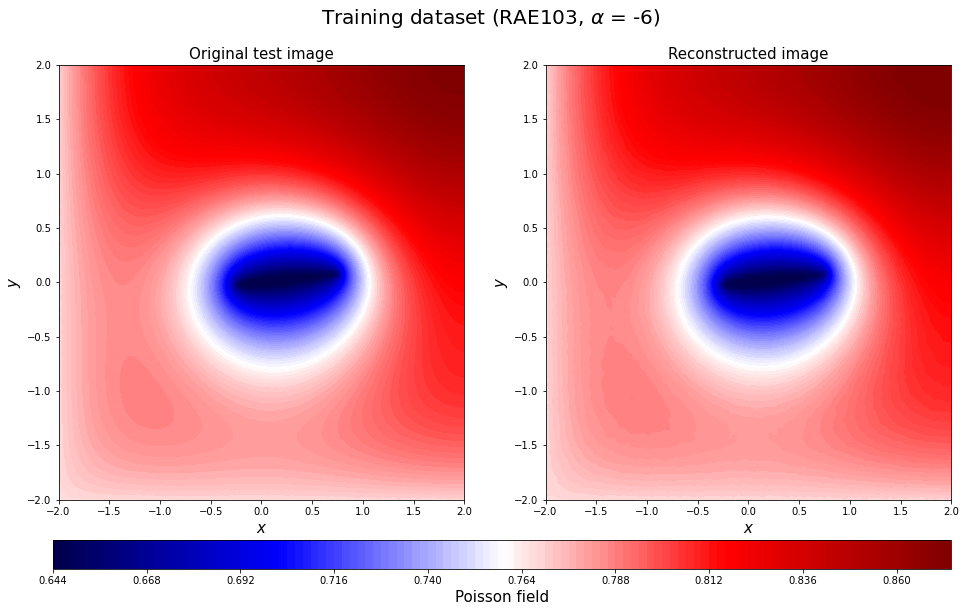

In [53]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train0_rotate = y_train[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train0_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[c])[3:-2], aa_train[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

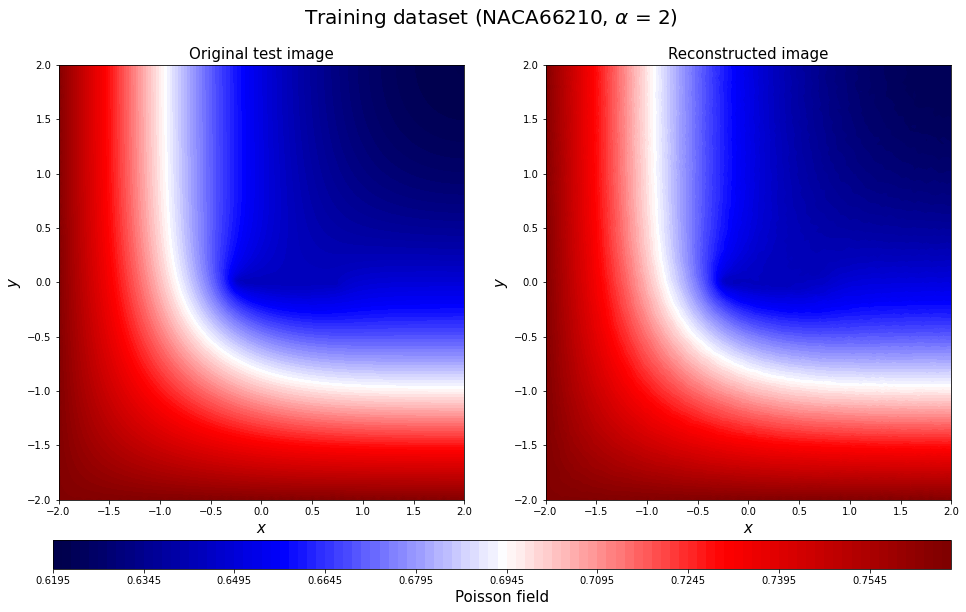

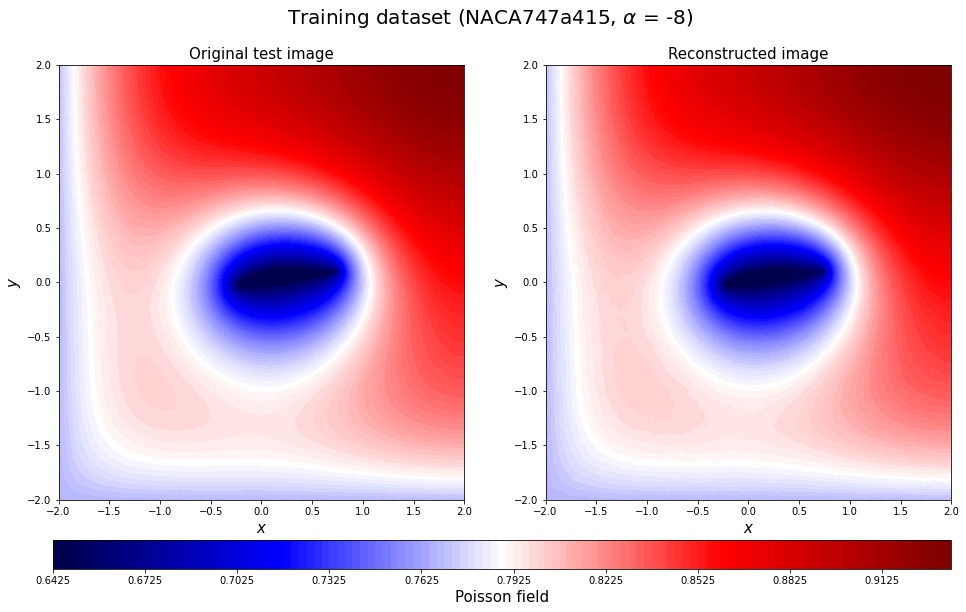

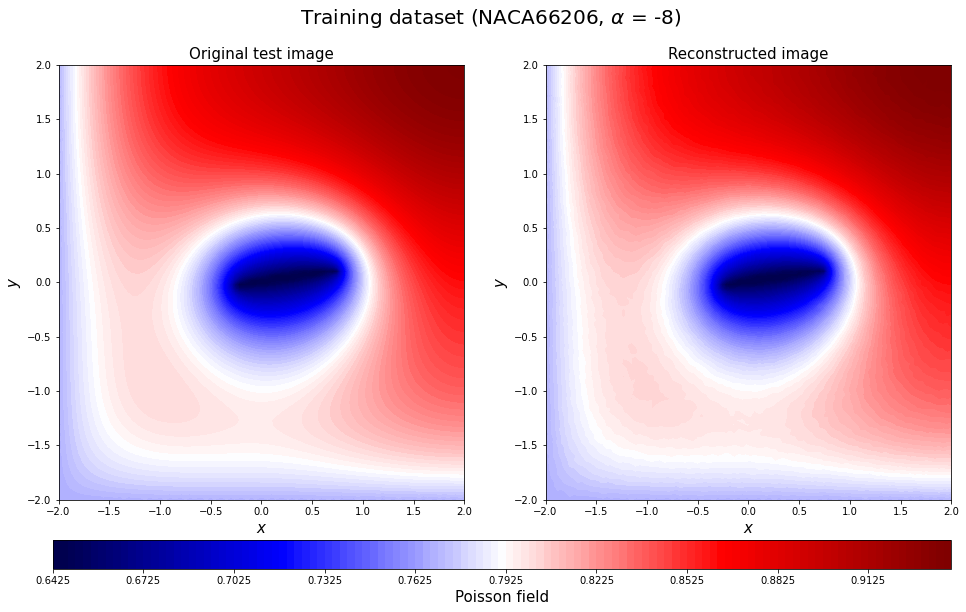

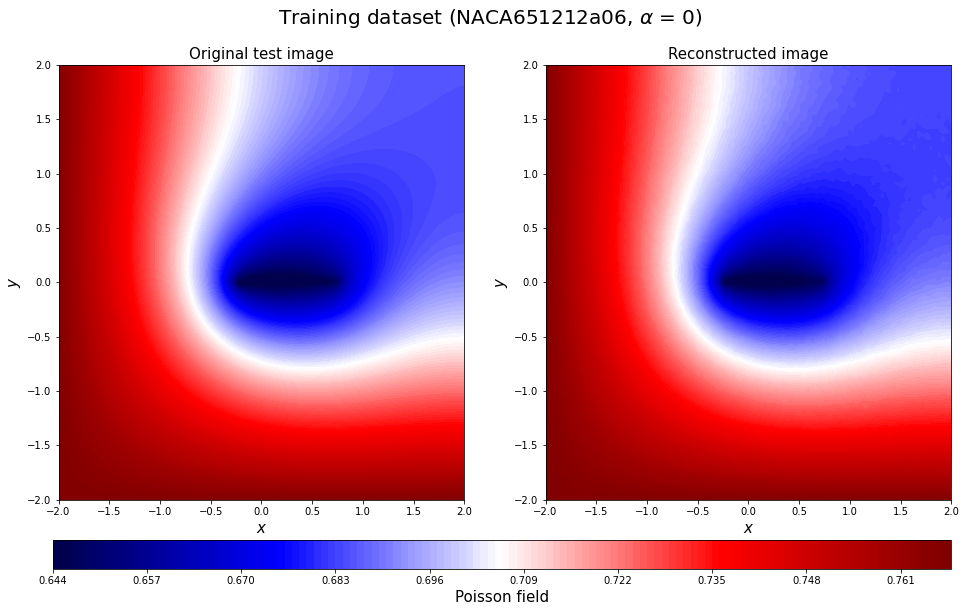

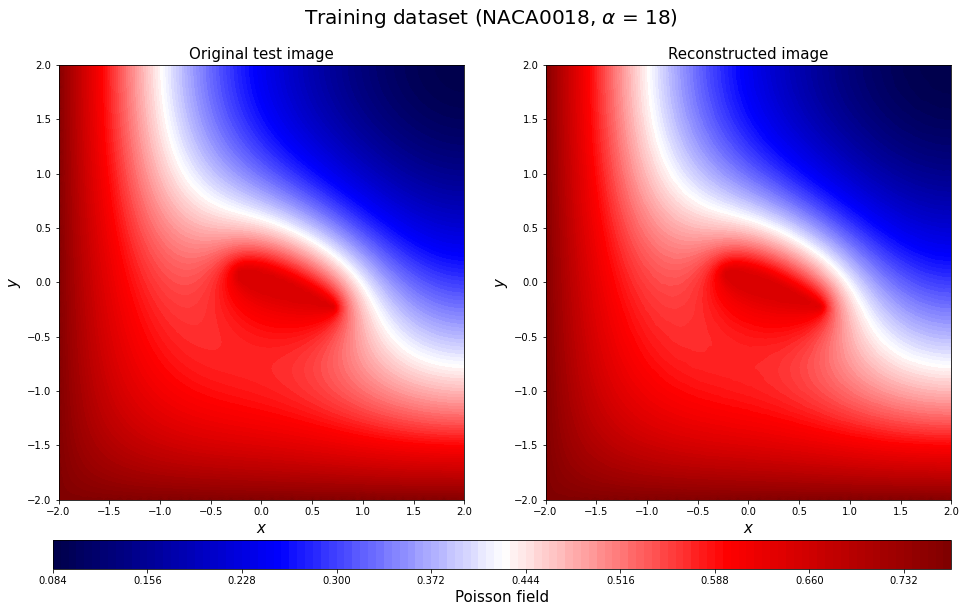

...

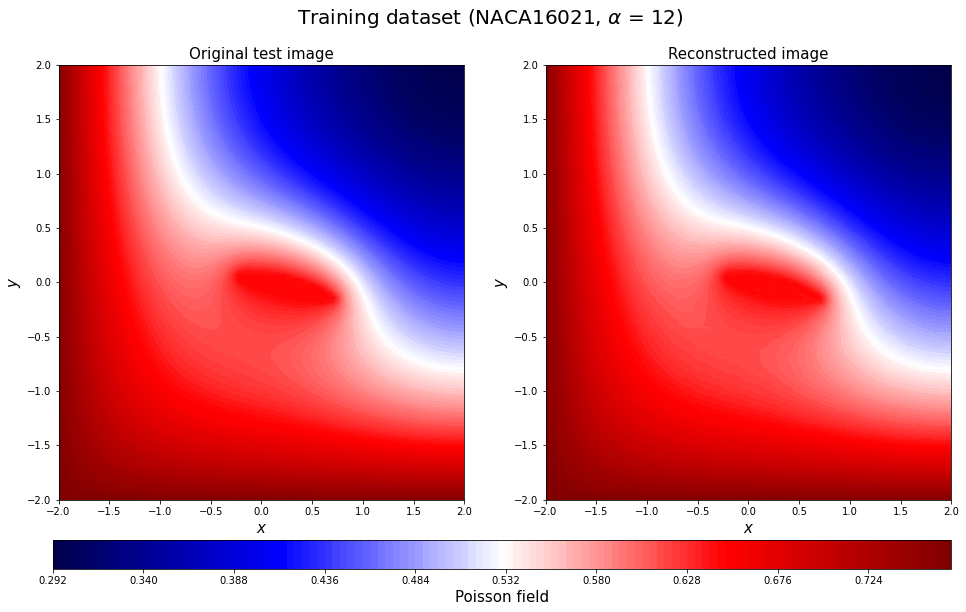

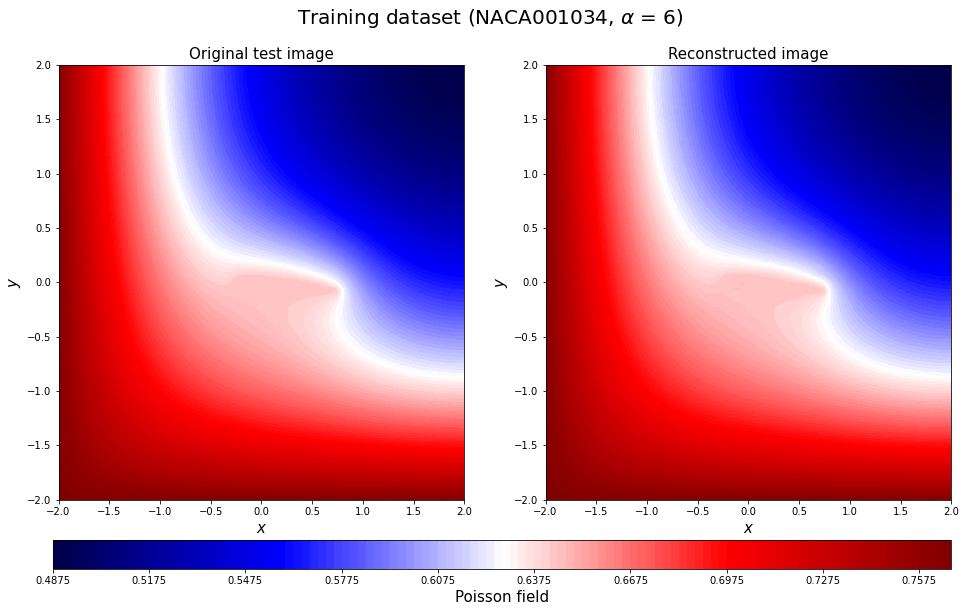

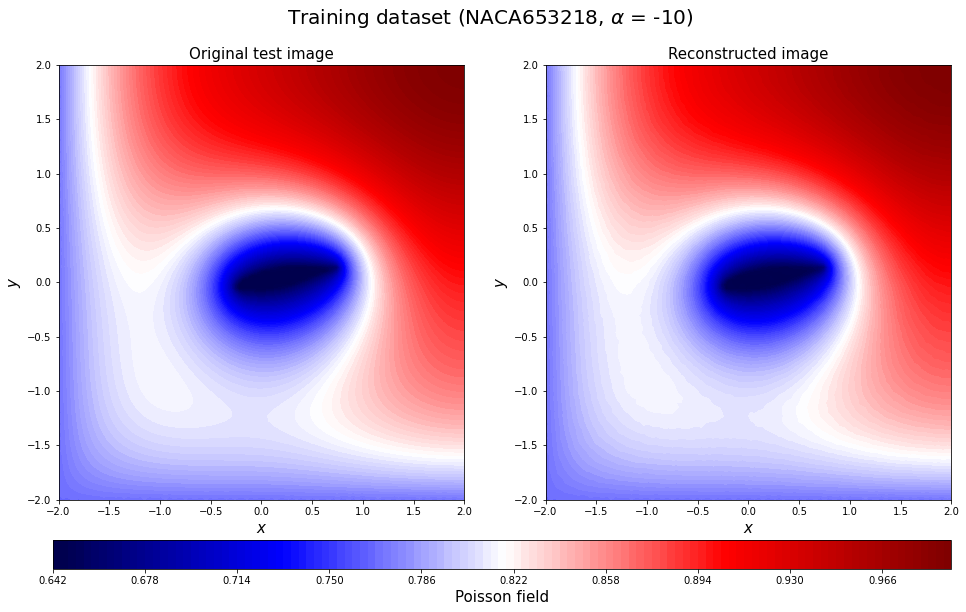

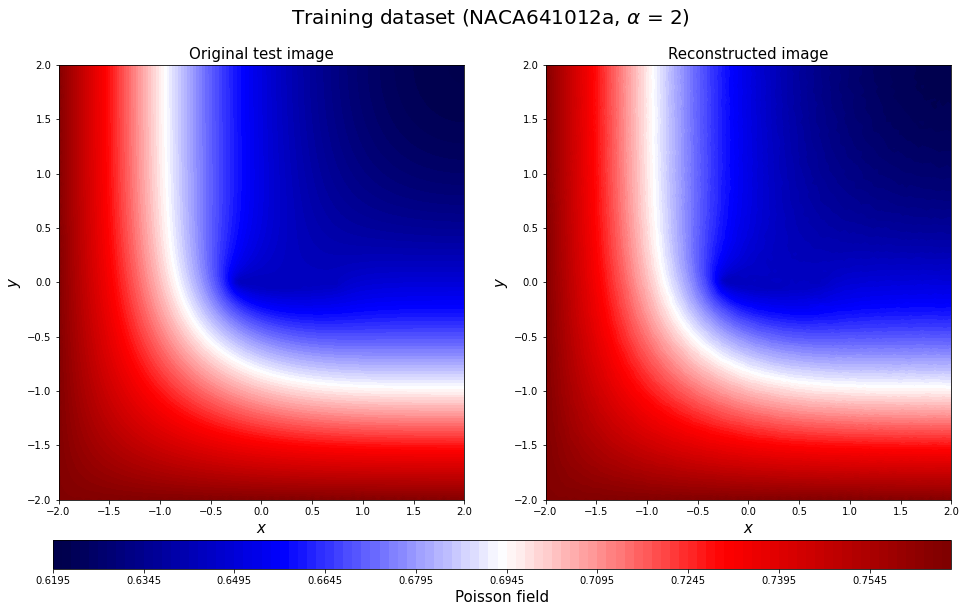

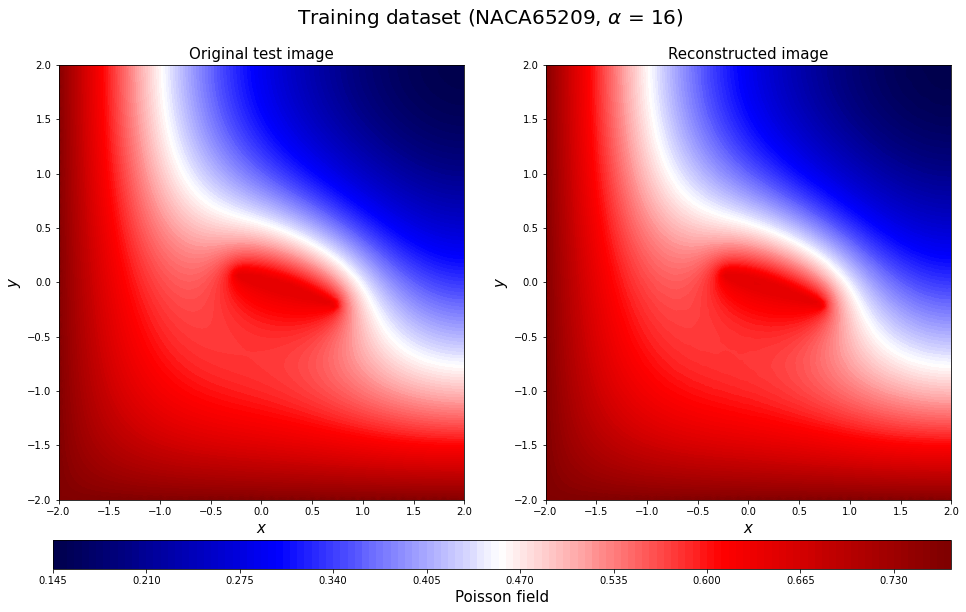

In [54]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train20_rotate = y_train[20*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[20*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train20_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[20*16+c])[3:-2], aa_train[20*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[20*16+c])[3:-2])+str(aa_train[20*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

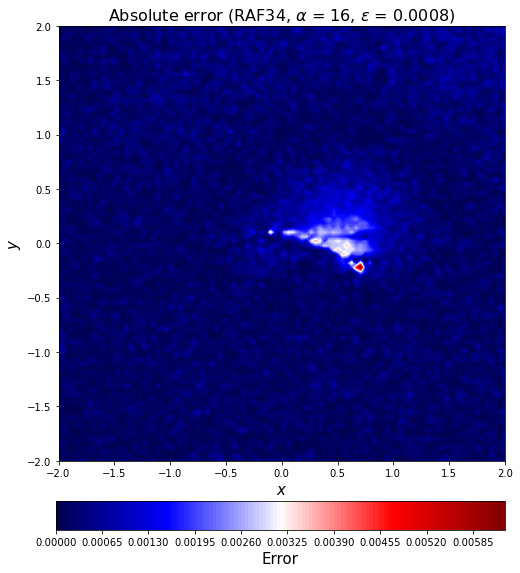

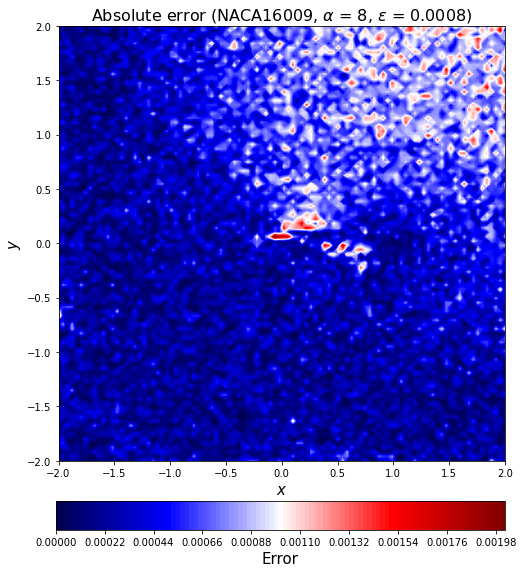

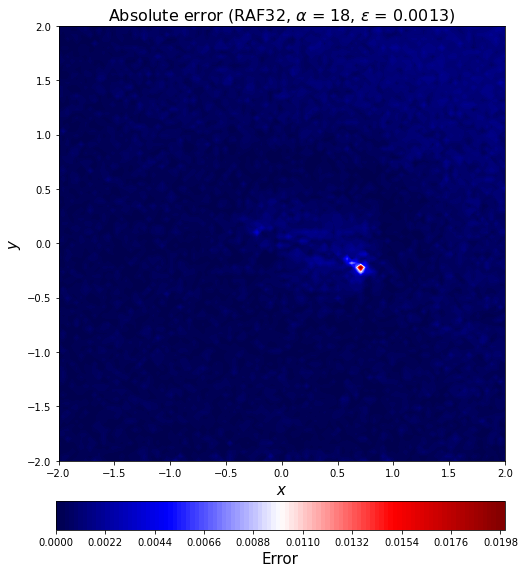

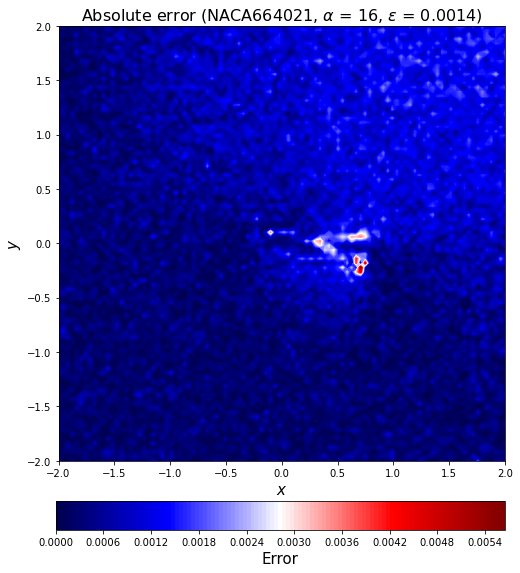

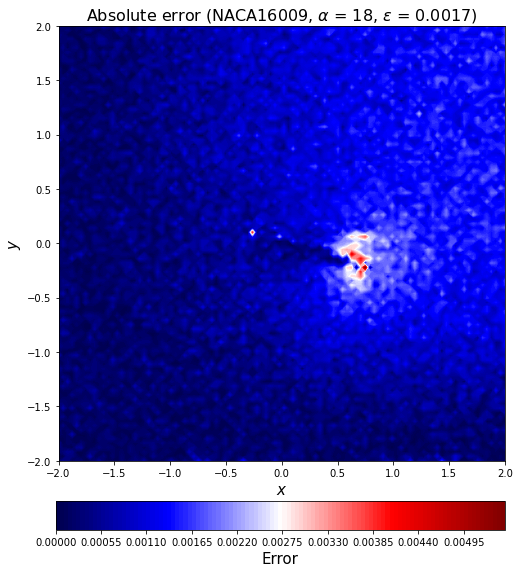

...

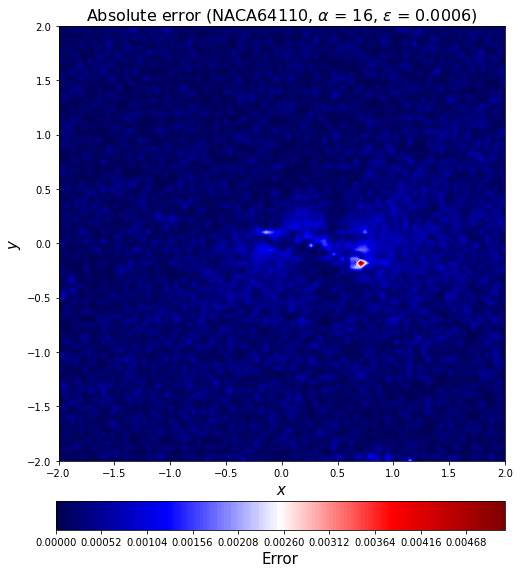

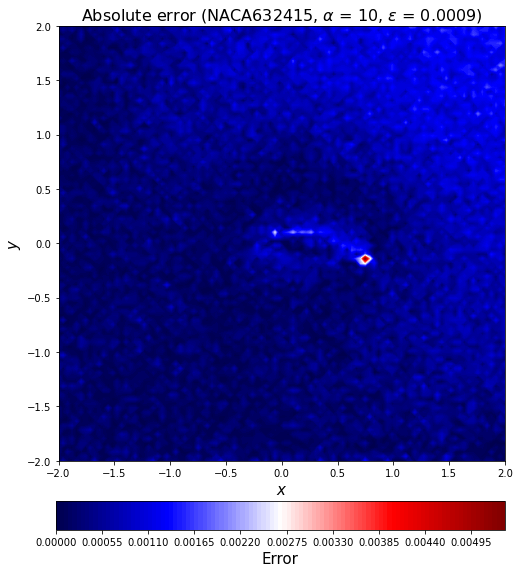

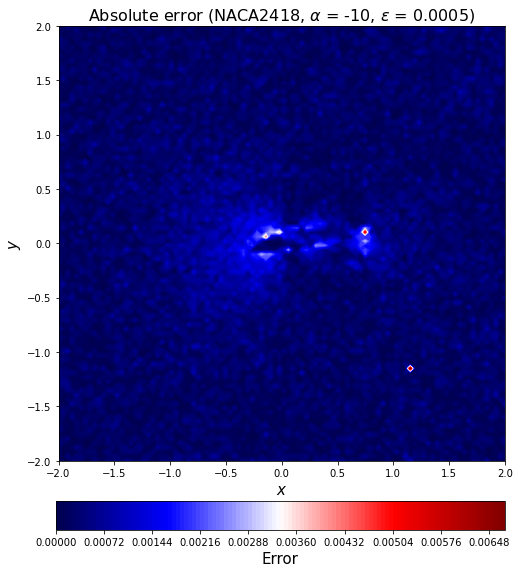

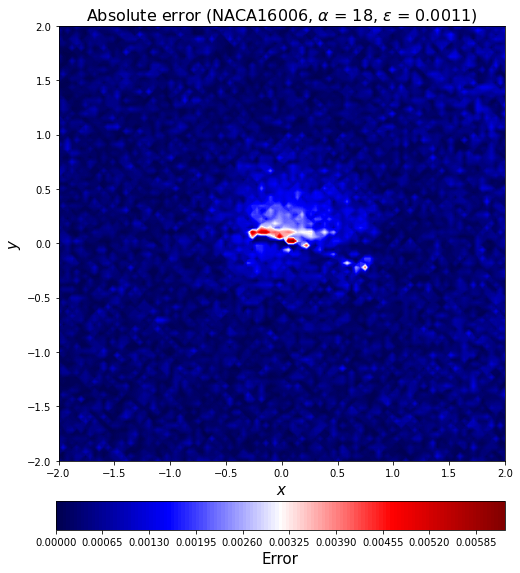

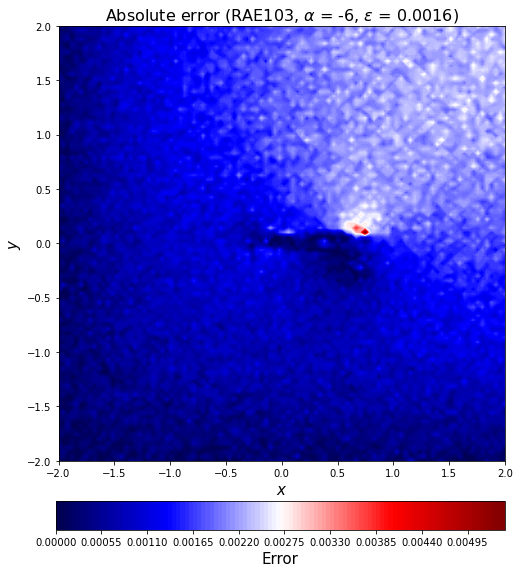

In [55]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[c])[3:-2],
                                                                             aa_train[c], l2_error_train_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])[3:-2]+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

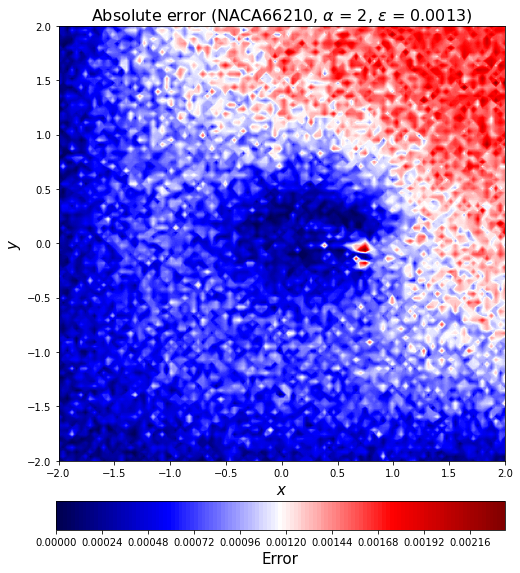

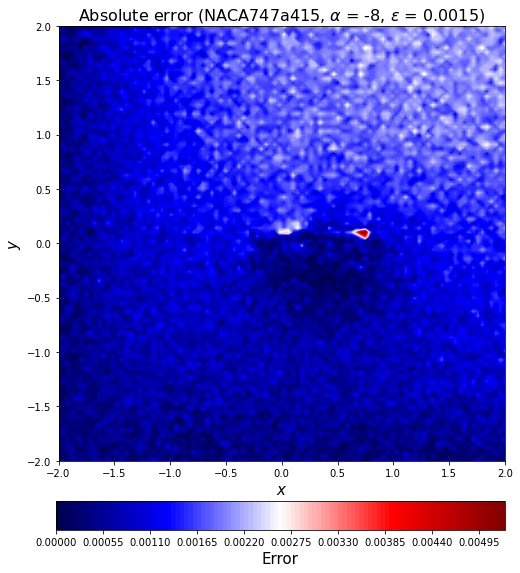

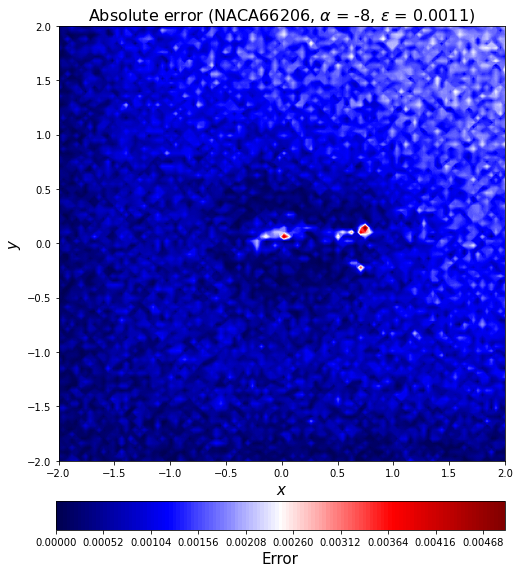

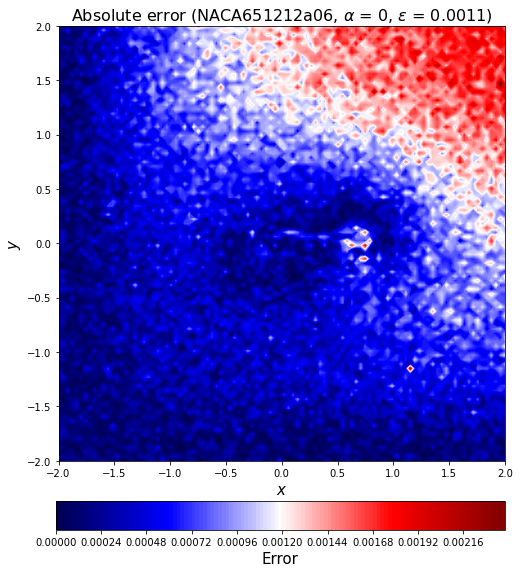

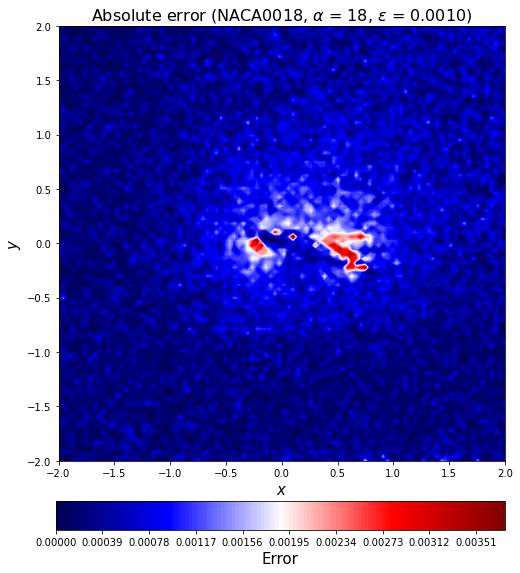

...

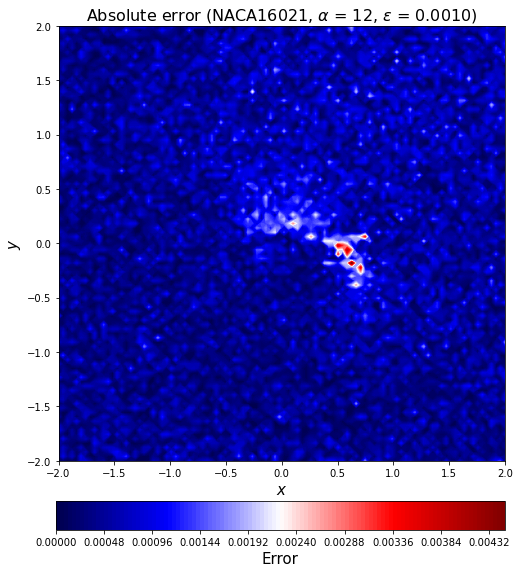

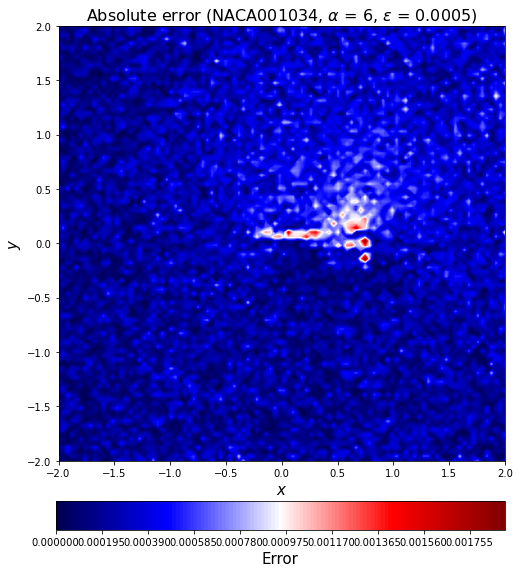

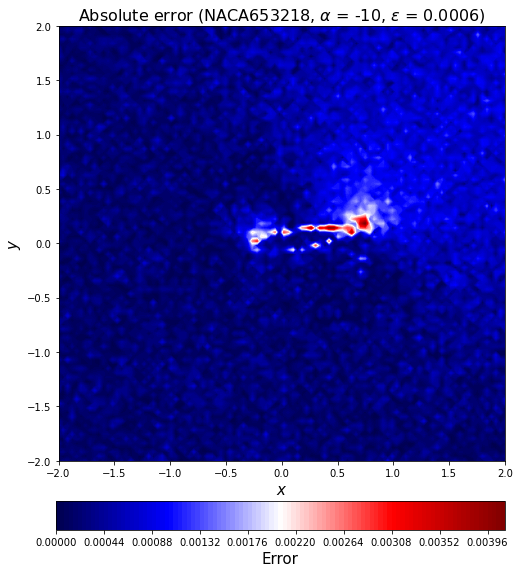

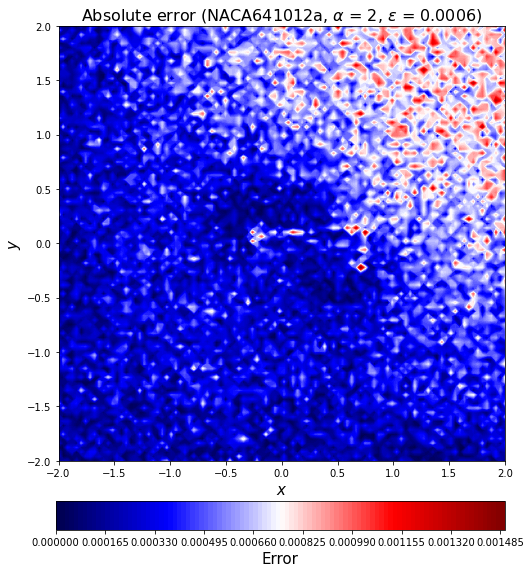

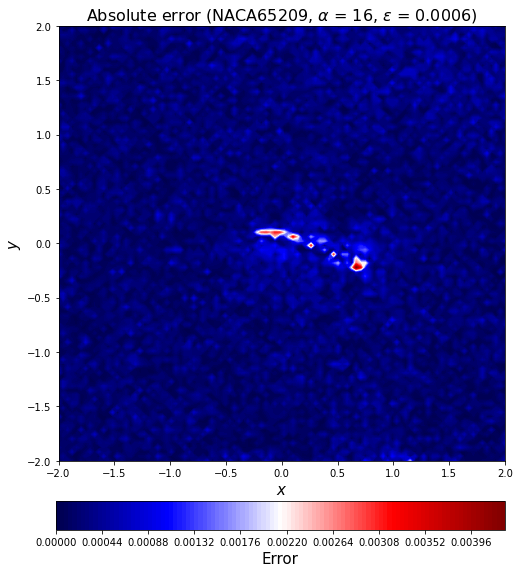

In [56]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[16*20+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[16*20+c])[3:-2],
                                                                             aa_train[16*20+c], l2_error_train_list[16*20+c]),fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[16*20+c])[3:-2])+str(aa_train[16*20+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

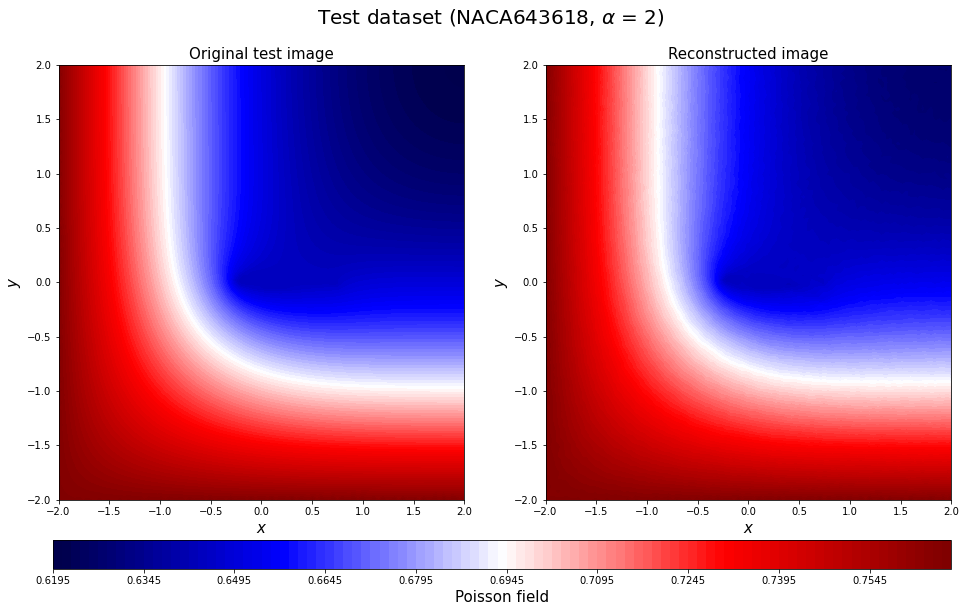

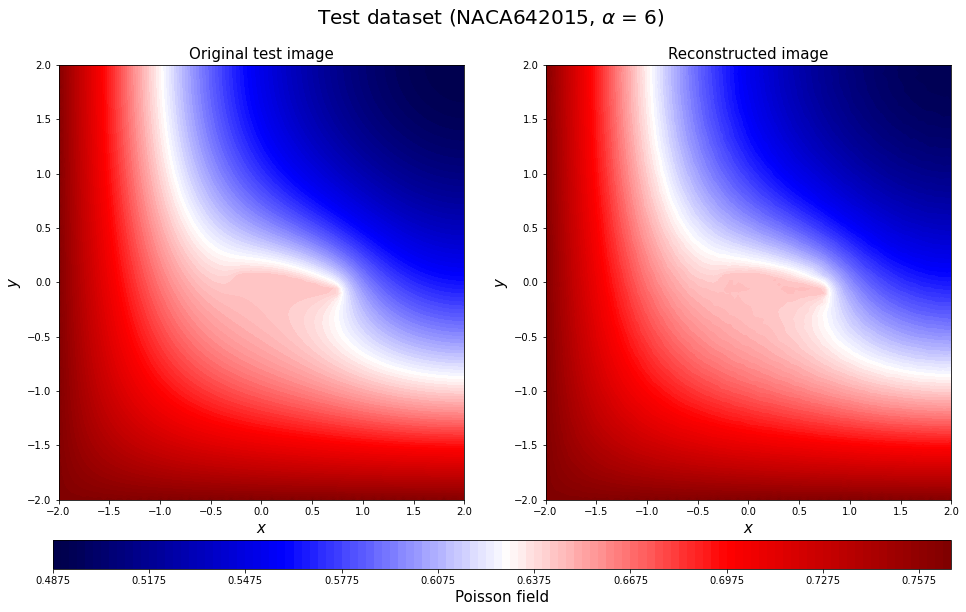

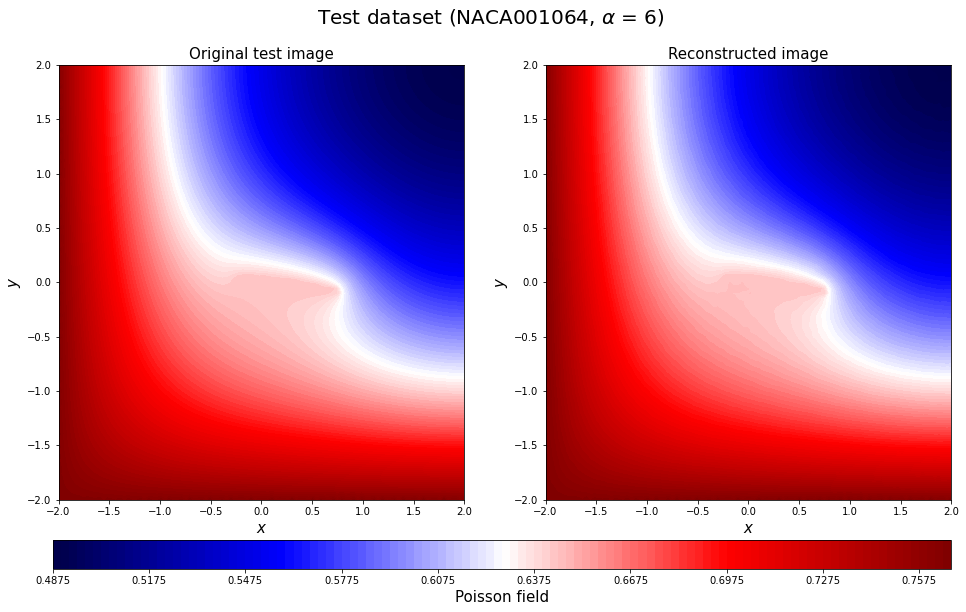

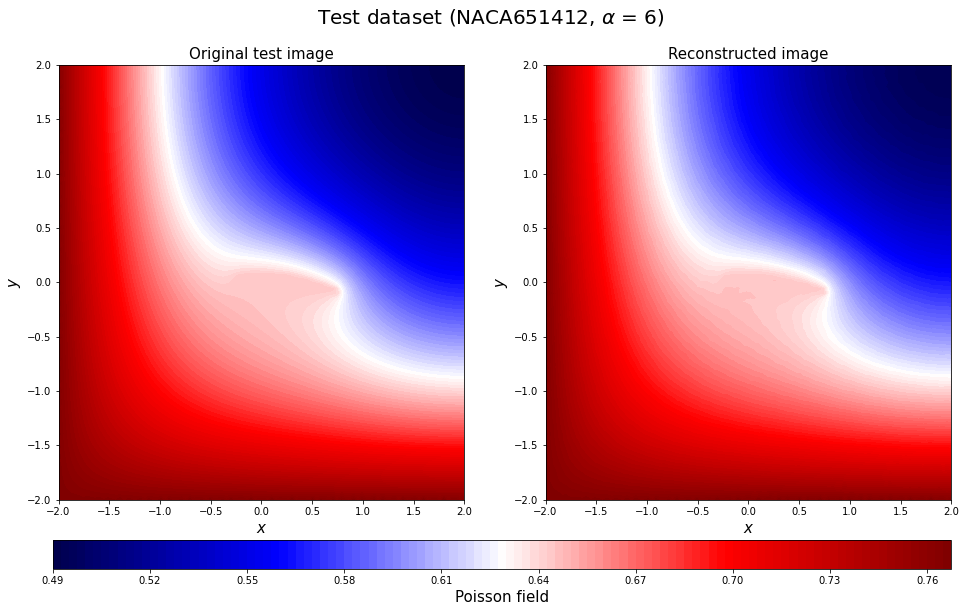

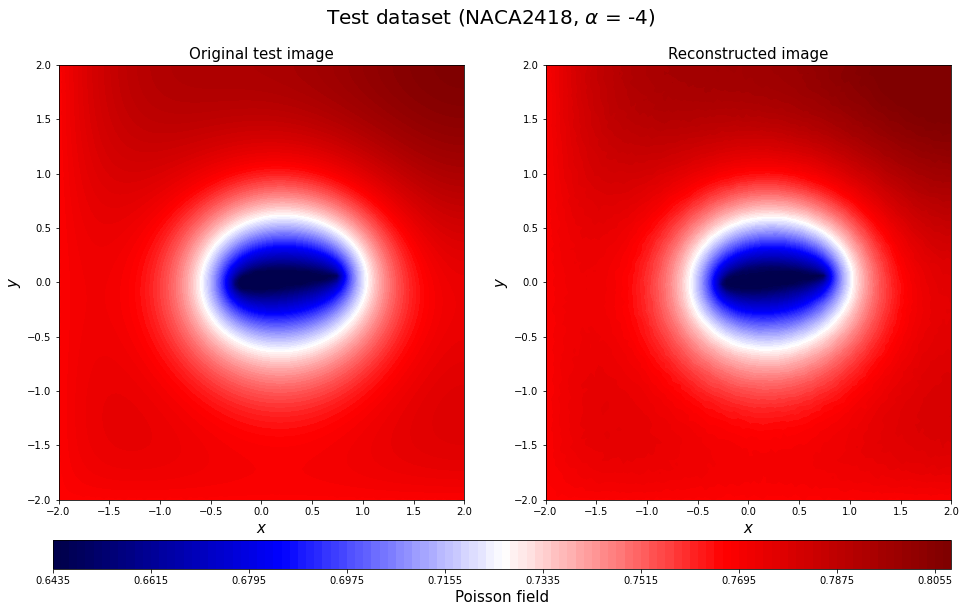

...

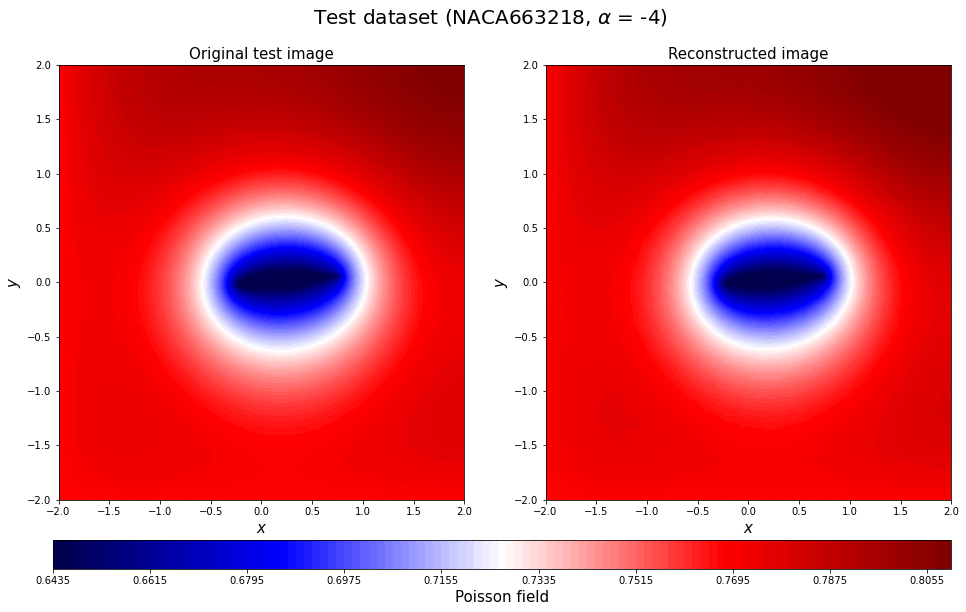

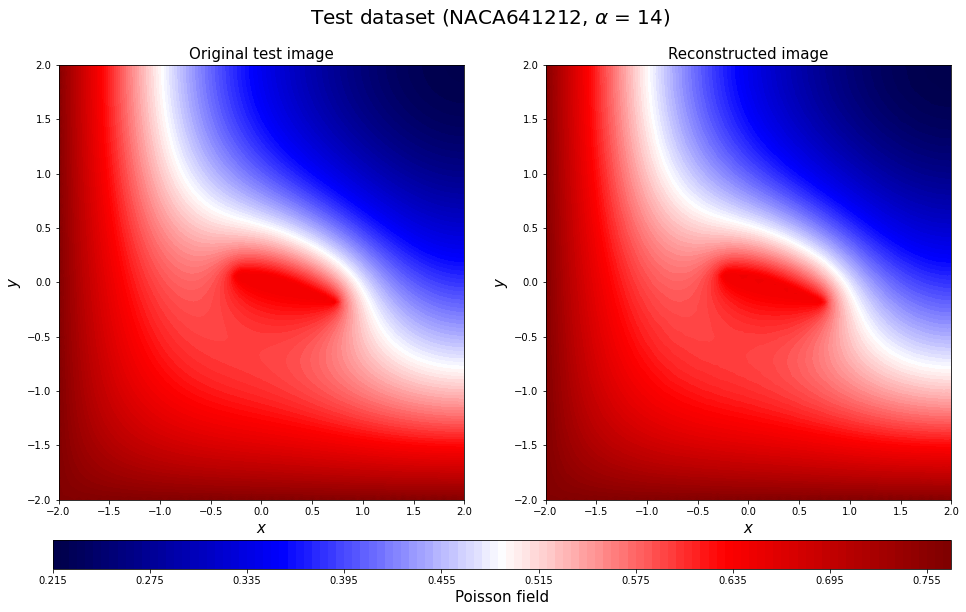

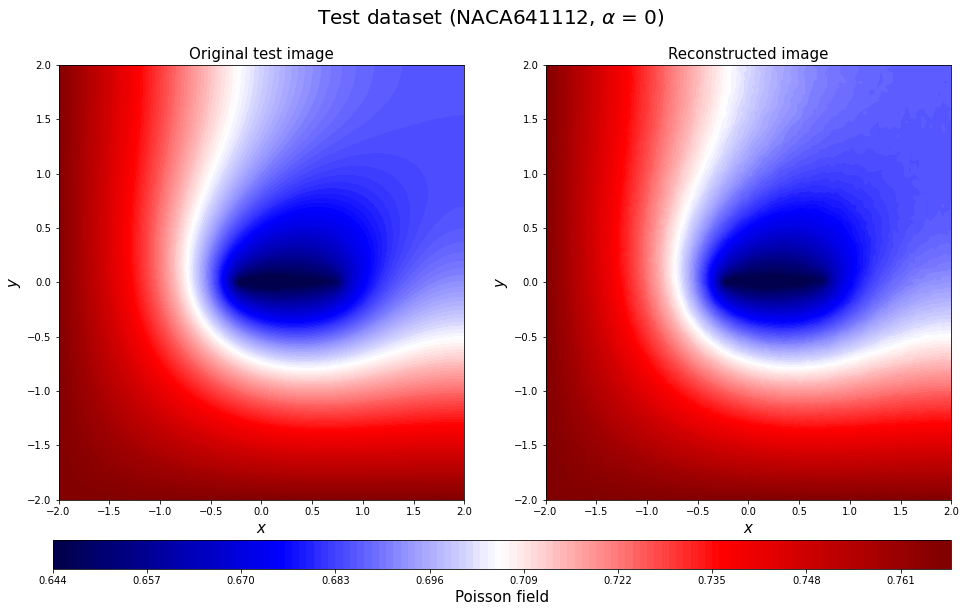

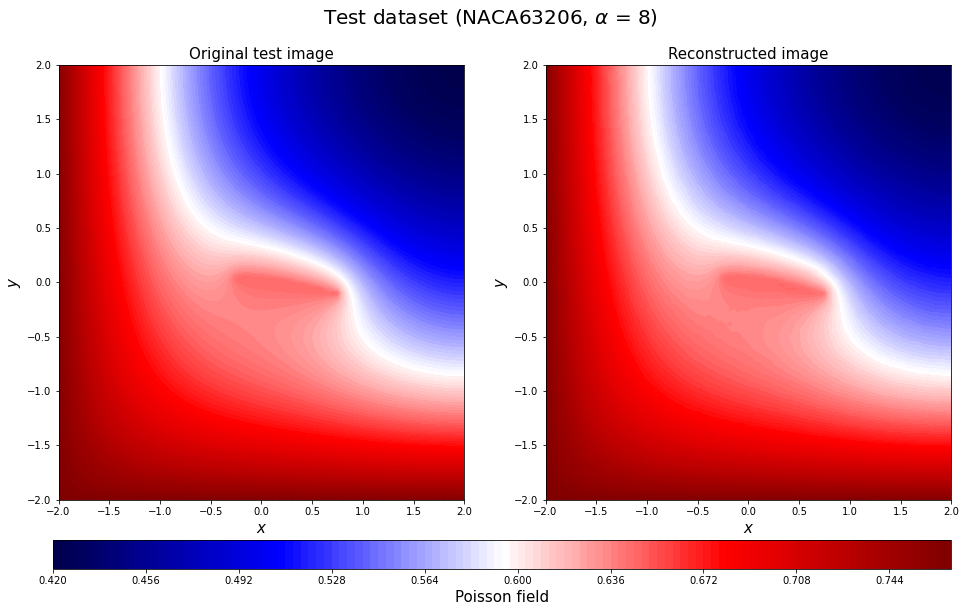

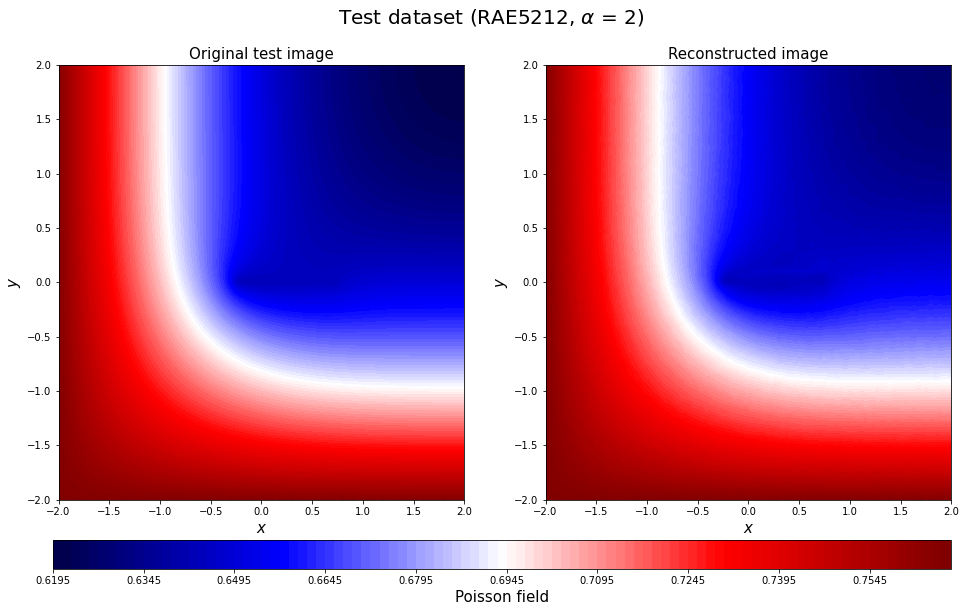

In [57]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test2_rotate = y_test[2*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[2*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test2_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[2*16+c])[3:-2], aa_test[2*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

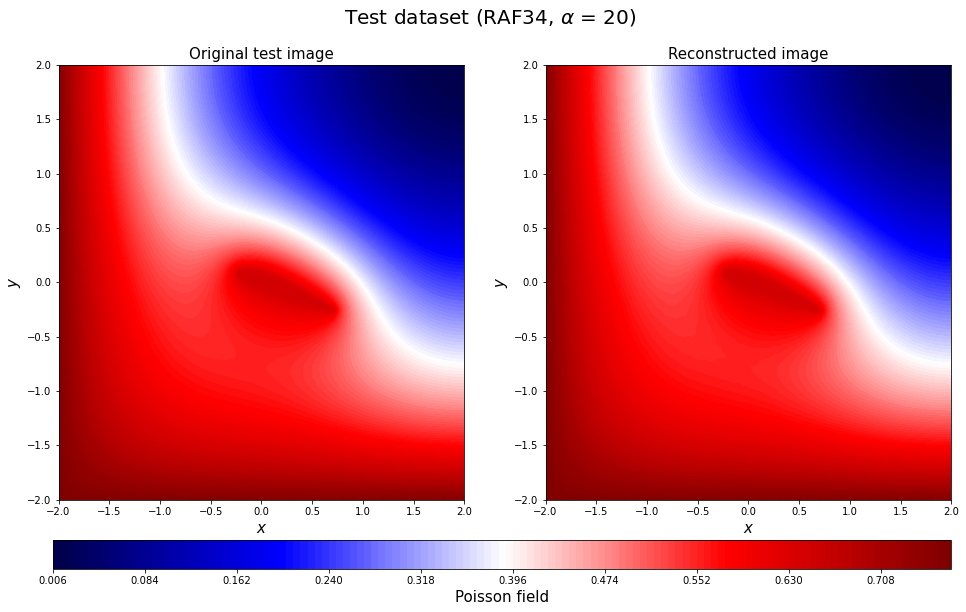

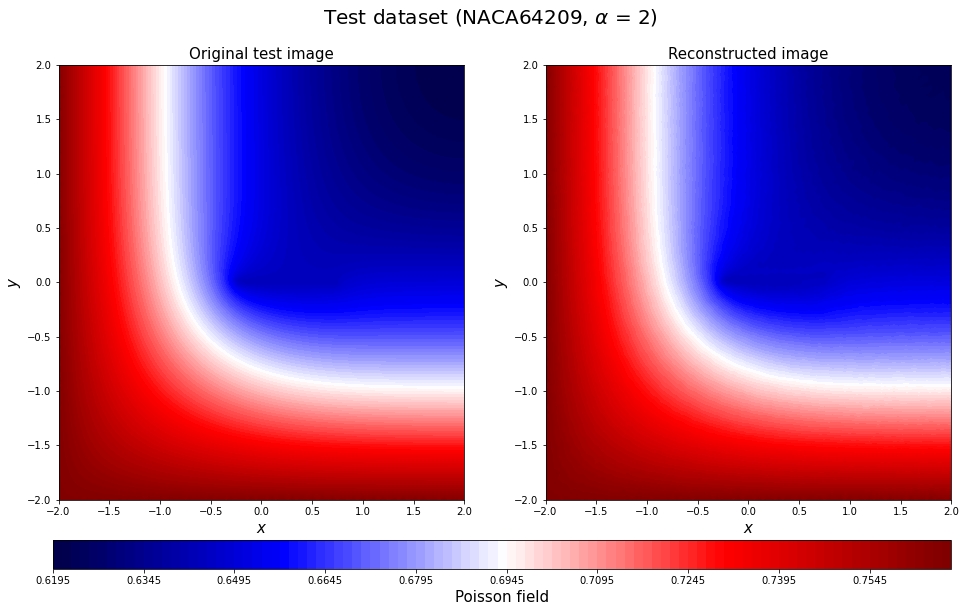

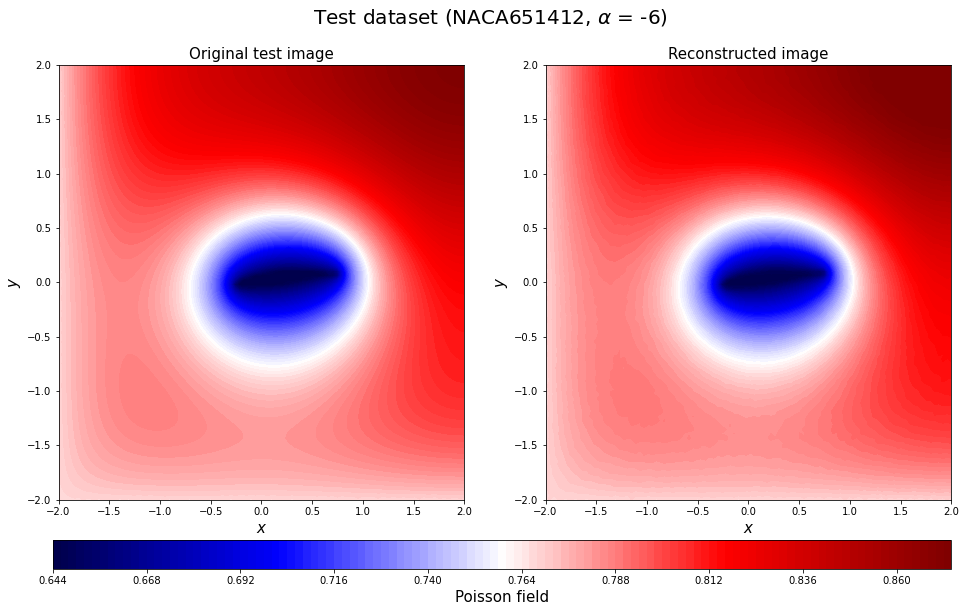

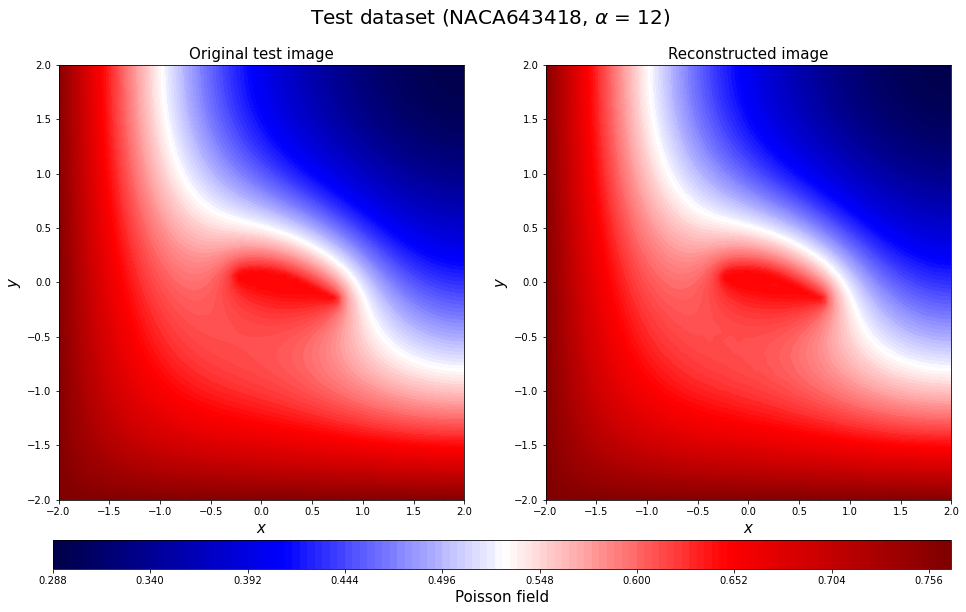

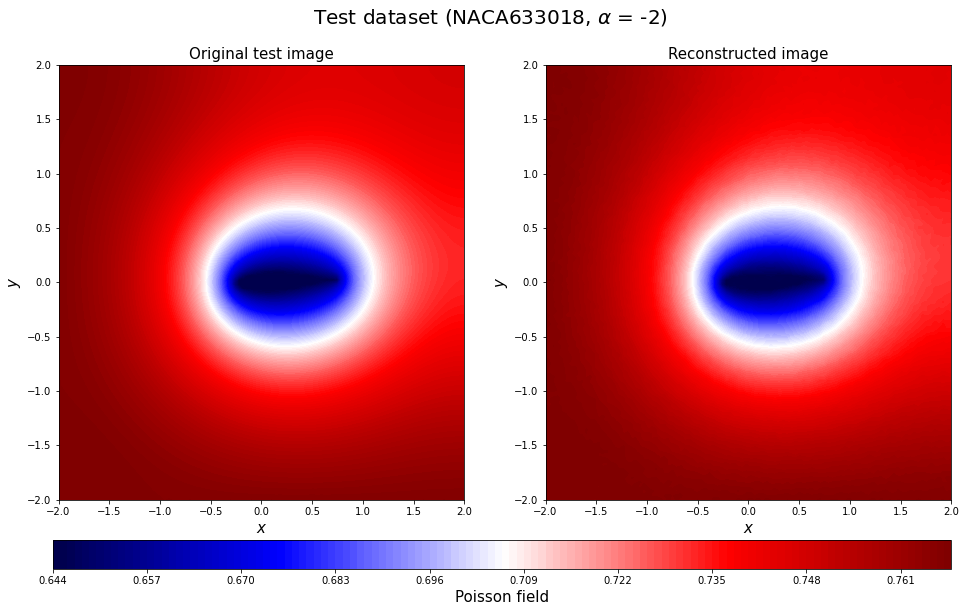

...

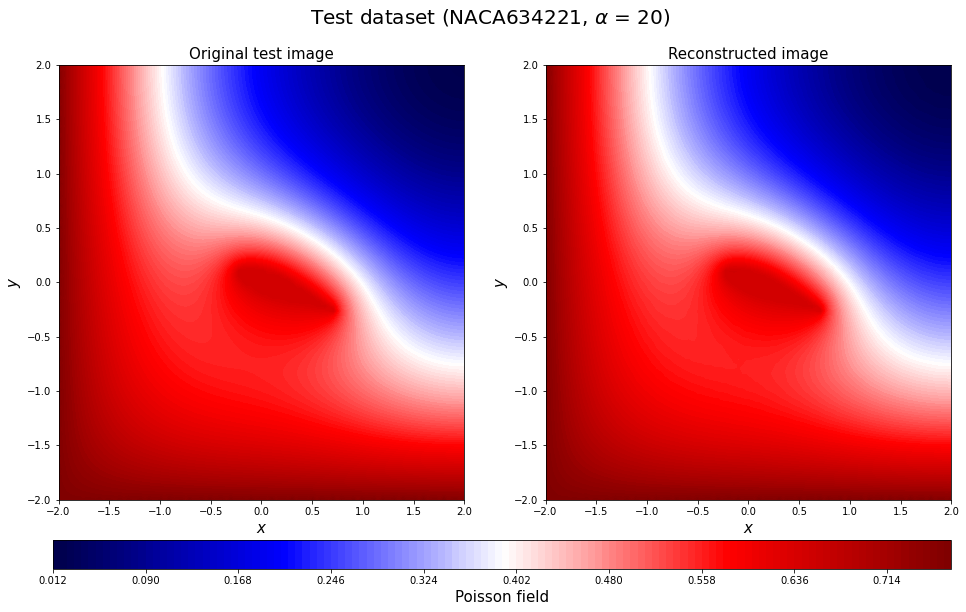

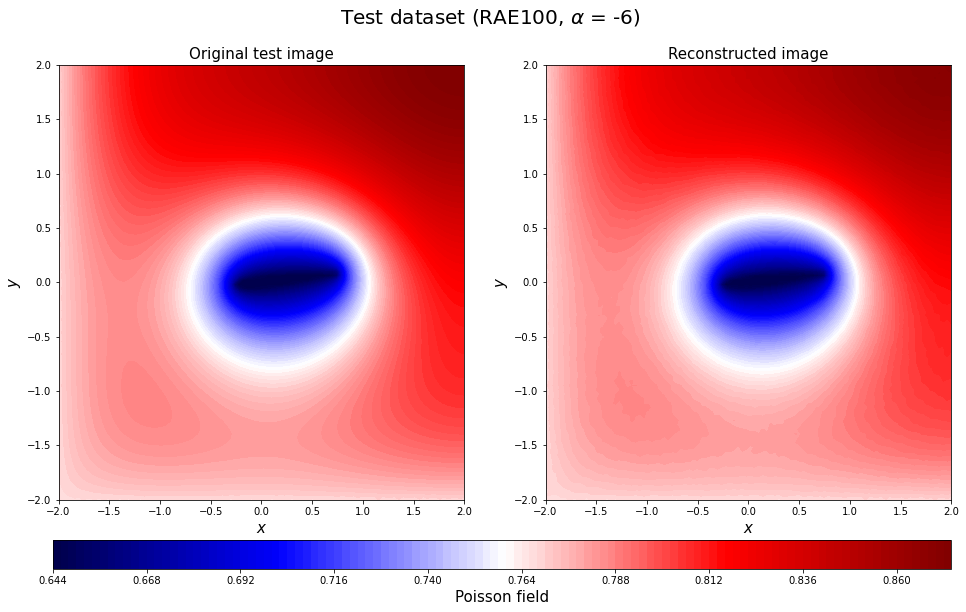

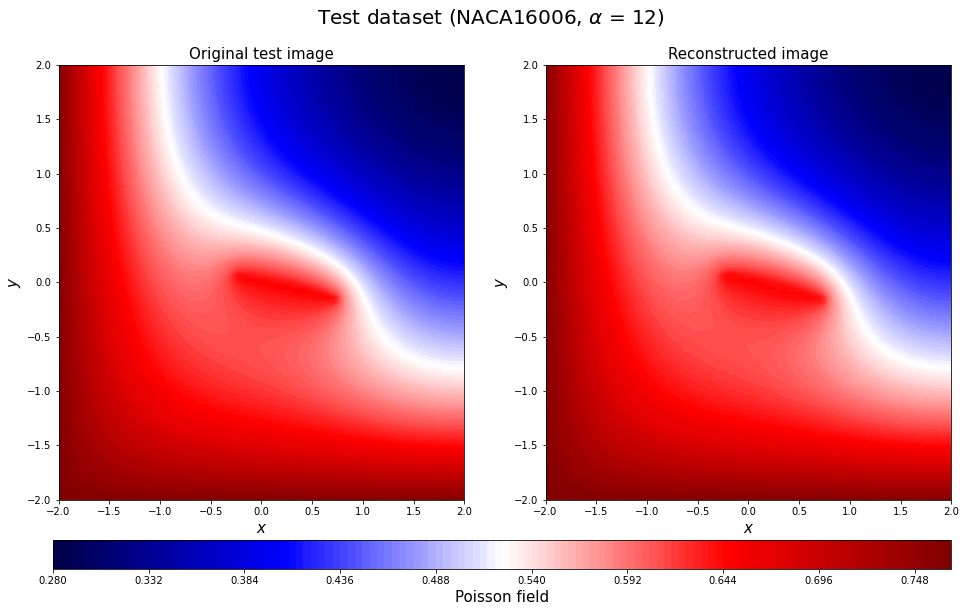

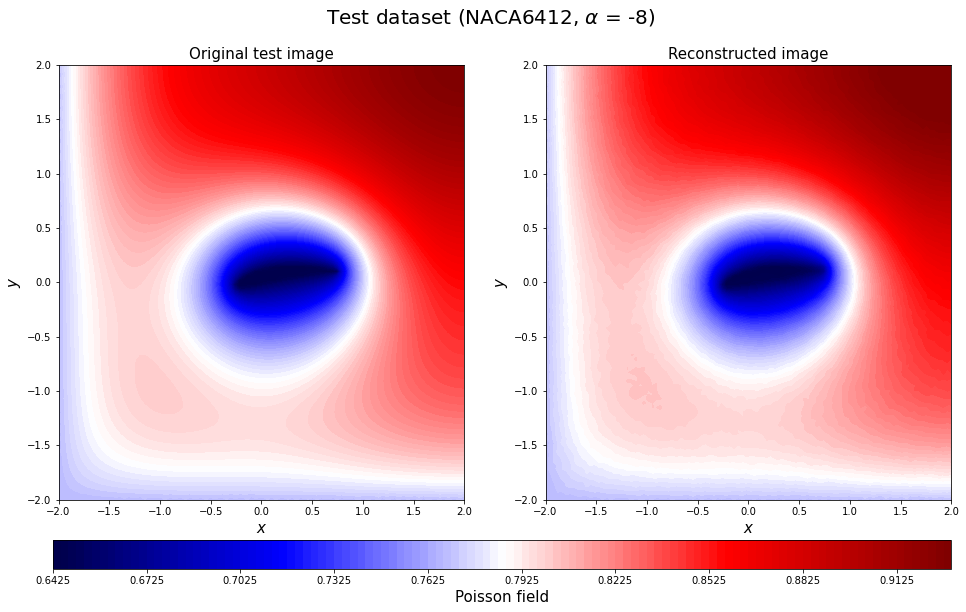

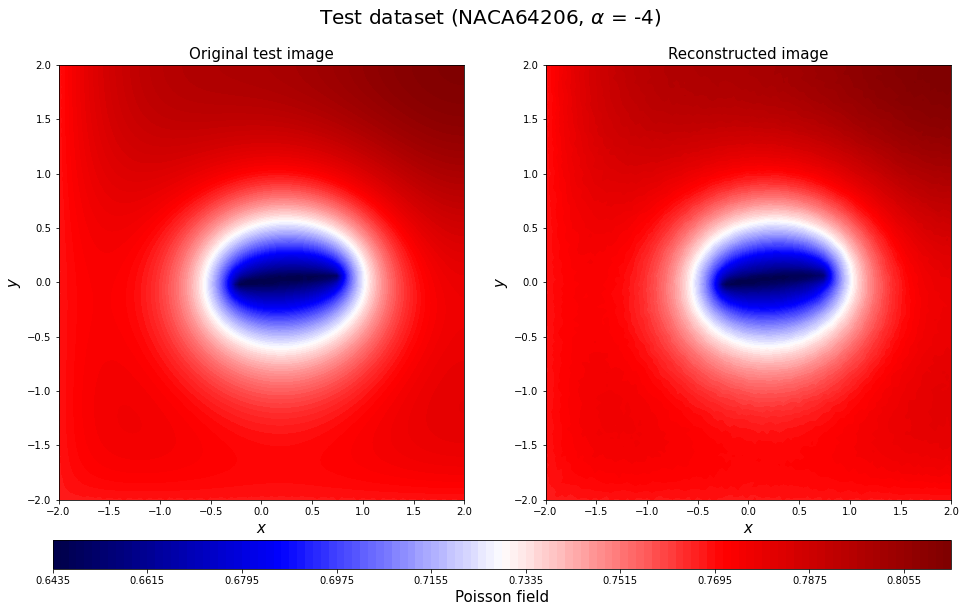

In [58]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

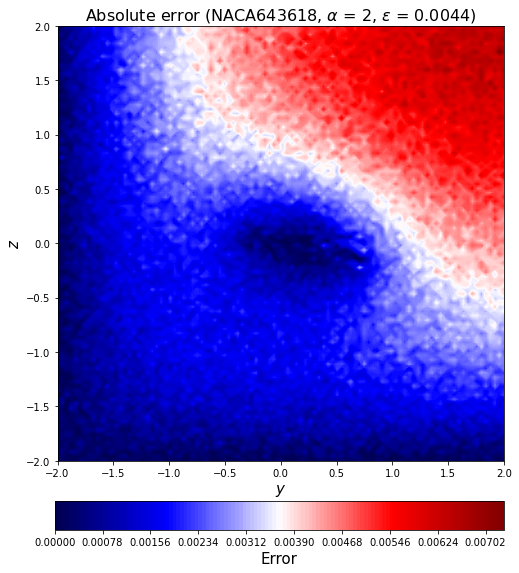

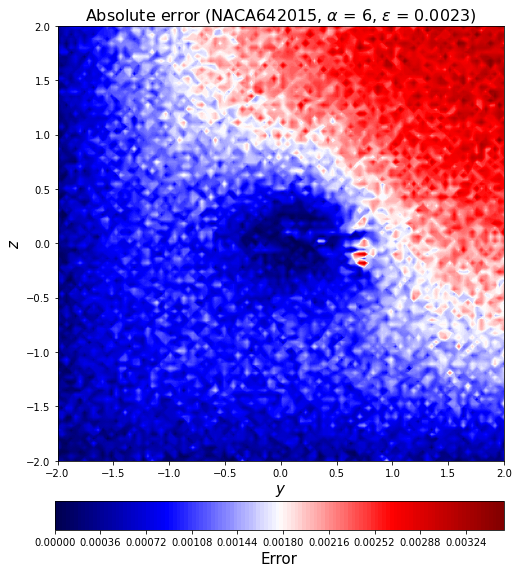

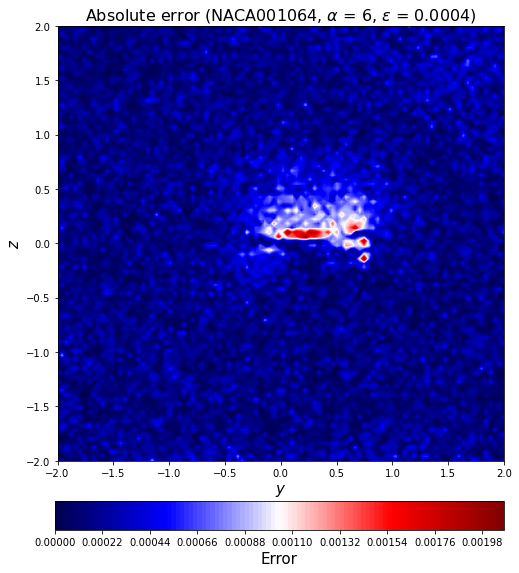

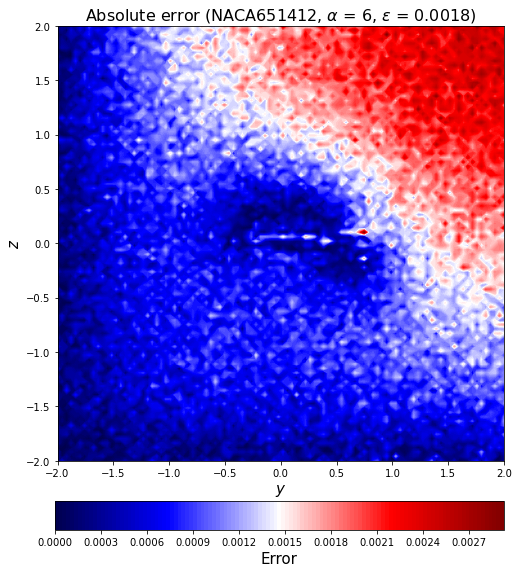

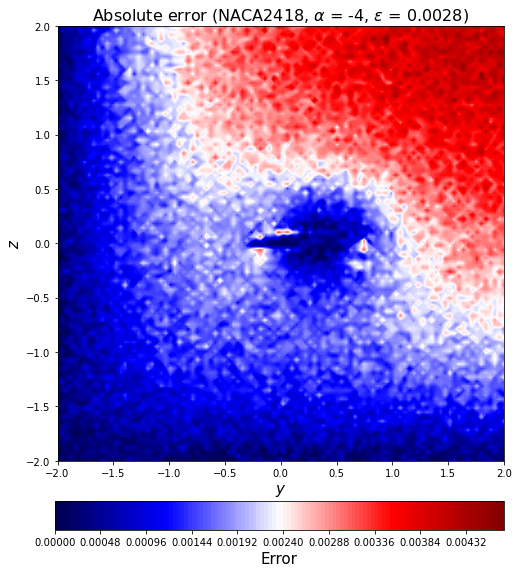

...

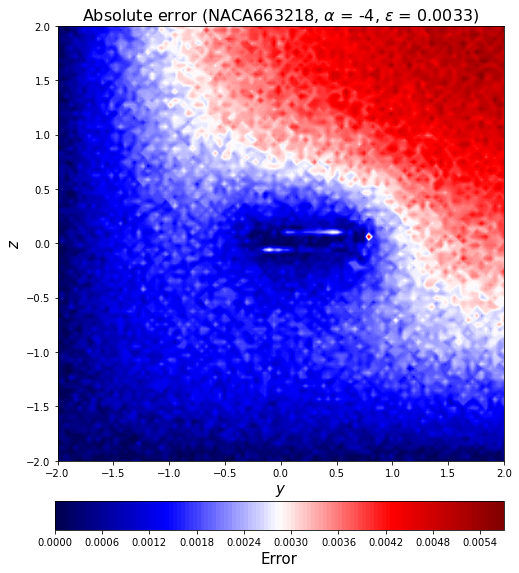

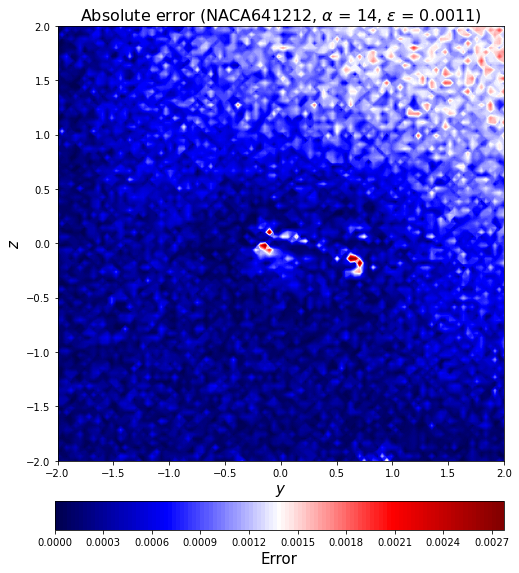

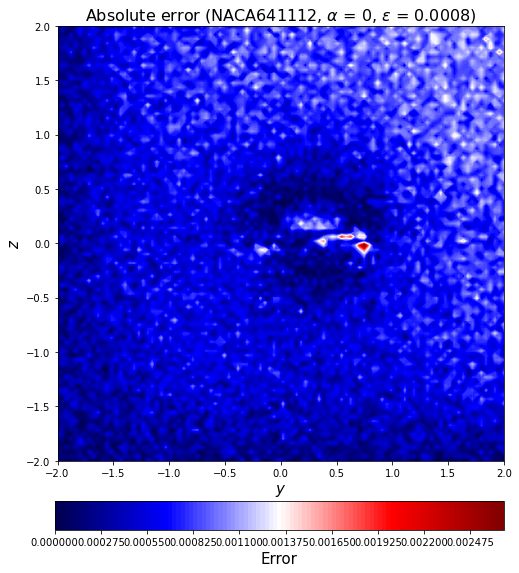

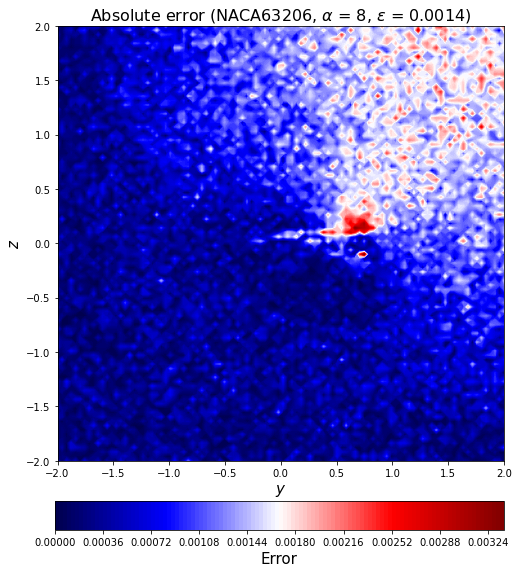

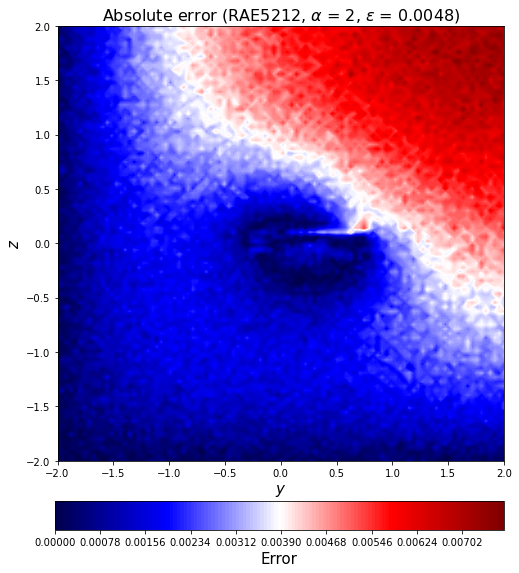

In [59]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[2*16+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[2*16+c])[3:-2],
                                                                       aa_test[2*16+c], l2_error_test_list[2*16+c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

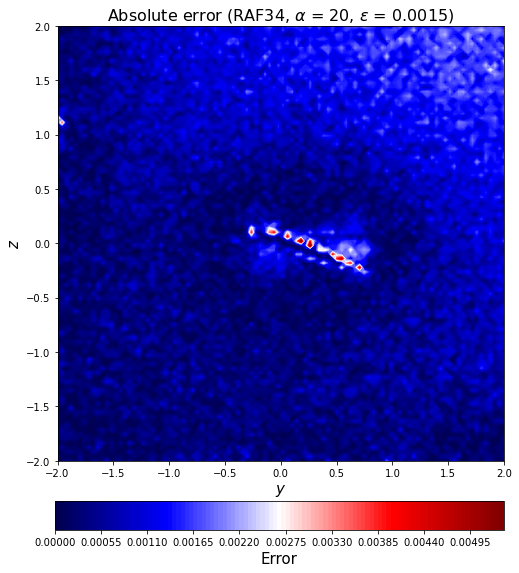

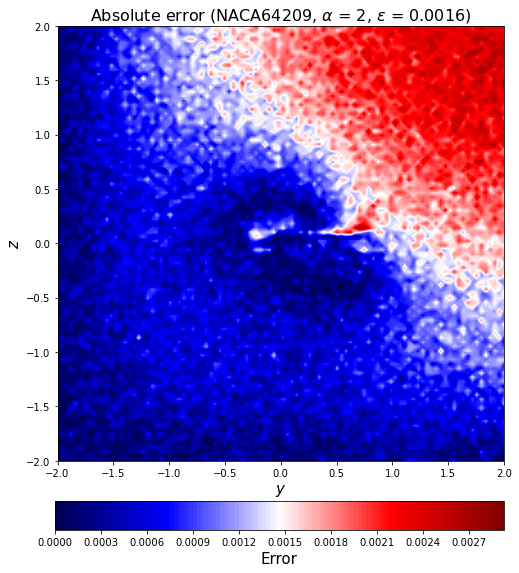

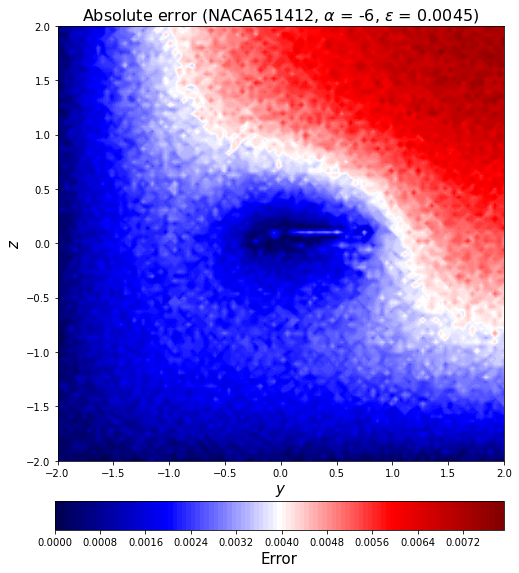

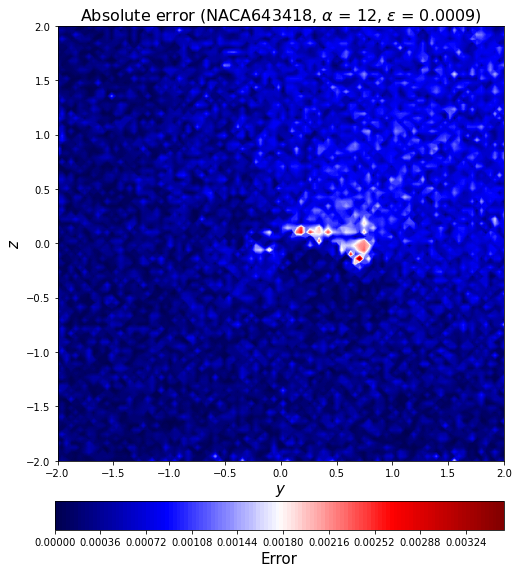

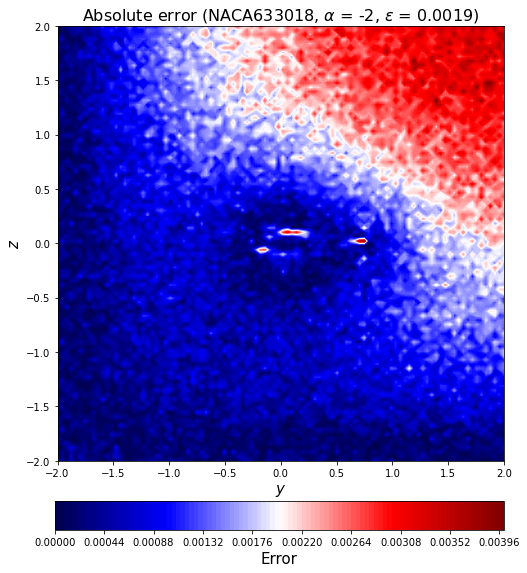

...

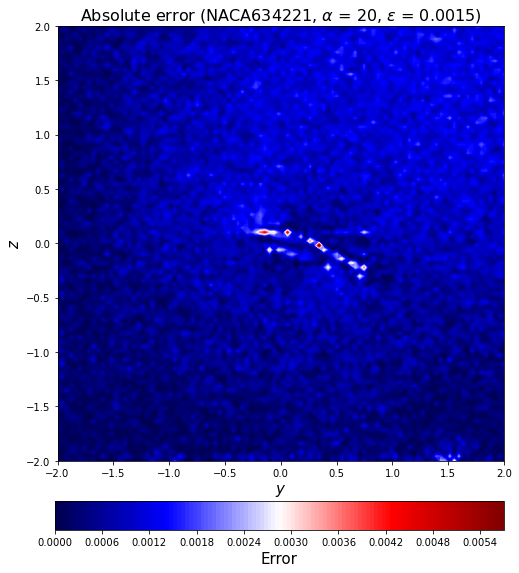

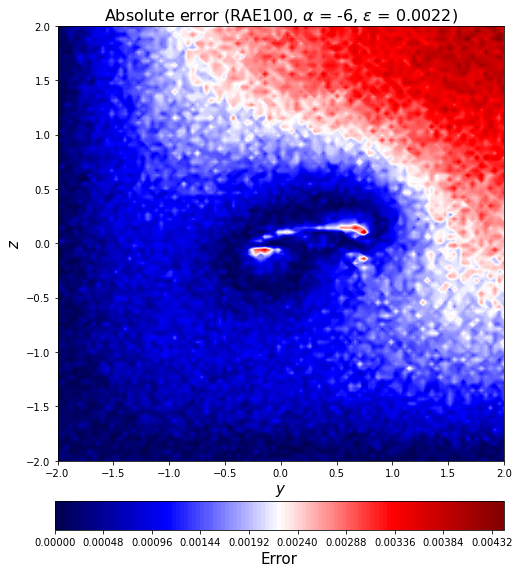

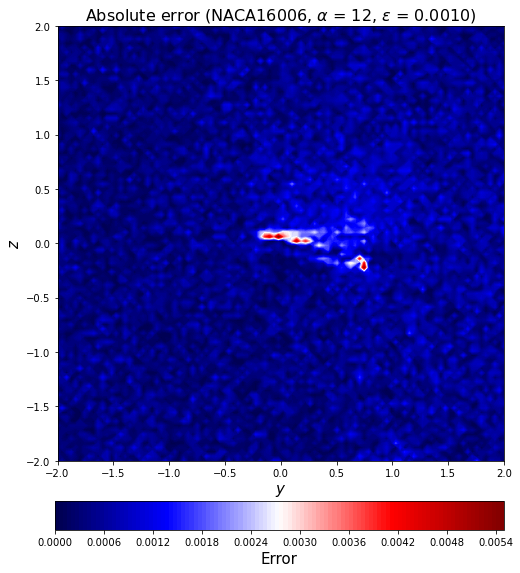

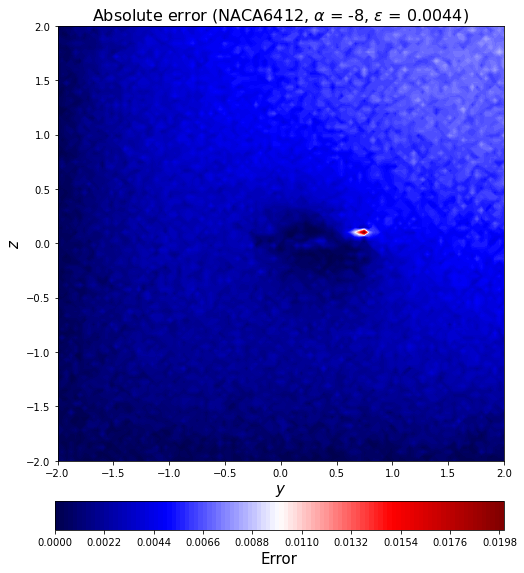

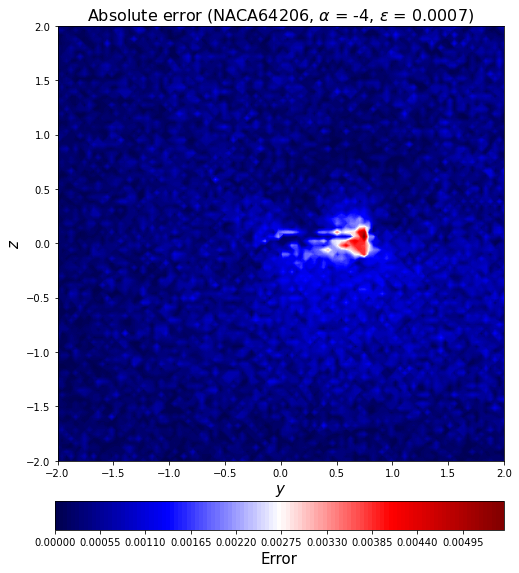

In [60]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

In [107]:
MAPE_train = (np.sum(np.abs(np.sum(y_train.reshape((-1, 100,100,1)).reshape((-1, 100,100,1)))-np.sum(decoded_train))) / np.abs(np.sum(y_train.reshape((-1, 100,100,1)))))/(y_train.reshape((-1, 100,100,1)).shape[0]/(x_train.shape[0]))*100
acc_train = 1-MAPE_train

In [109]:
MAPE_val = (np.sum(np.abs(np.sum(y_val.reshape((-1, 100,100,1)))-np.sum(decoded_val))) / np.abs(np.sum(y_val.reshape((-1, 100,100,1)))))/(y_val.reshape((-1, 100,100,1)).shape[0]/(x_val.shape[0]))*100
acc_val = 1-MAPE_val

In [111]:
MAPE_test = (np.sum(np.abs(np.sum(y_test.reshape((-1, 100,100,1)))-np.sum(decoded_test))) / np.abs(np.sum(y_test.reshape((-1, 100,100,1)))))/(y_test.reshape((-1, 100,100,1)).shape[0]/(x_test.shape[0]))*100
acc_test = 1-MAPE_test

In [108]:
print(MAPE_train)
print(acc_train)

0.03476277771902913
0.9652372222809709


In [110]:
print(MAPE_val)
print(acc_val)

0.02449371566576594
0.975506284334234


In [112]:
print(MAPE_test)
print(acc_test)

0.04016187119531908
0.9598381288046809


In [113]:
MAPE_train_list = []
acc_train_list = []
for i in range(0, len(aa_train)):
    MAPE_train_data = (np.sum(np.abs(y_train.reshape((-1, 100,100,1))[i]-decoded_train[i])) / np.sum(np.abs(y_train.reshape((-1, 100,100,1))[i])))/(y_train.reshape((-1, 100,100,1)).shape[0]/16)*100
    MAPE_train_list.append(MAPE_train_data)
    acc_train_data = 1 - MAPE_train_data
    acc_train_list.append(acc_train_data)

In [114]:
MAPE_val_list = []
acc_val_list = []
for i in range(0, len(aa_val)):
    MAPE_val_data = (np.sum(np.abs(y_val.reshape((-1, 100,100,1))[i]-decoded_val[i])) / np.sum(np.abs(y_val.reshape((-1, 100,100,1))[i])))/(y_val.reshape((-1, 100,100,1)).shape[0]/16)*100
    MAPE_val_list.append(MAPE_val_data)
    acc_val_data = 1 - MAPE_val_data
    acc_val_list.append(acc_val_data)

In [115]:
MAPE_test_list = []
acc_test_list = []
for i in range(0, len(aa_test)):
    MAPE_test_data = (np.sum(np.abs(y_test.reshape((-1, 100,100,1))[i]-decoded_test[i])) / np.sum(np.abs(y_test.reshape((-1, 100,100,1))[i])))/(y_test.reshape((-1, 100,100,1)).shape[0]/16)*100
    MAPE_test_list.append(MAPE_test_data)
    acc_test_data = 1 - MAPE_test_data
    acc_test_list.append(acc_test_data)

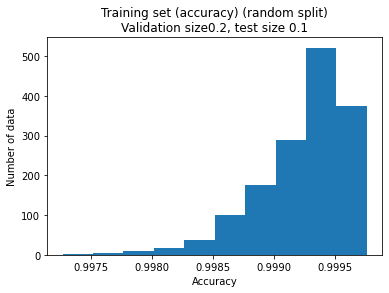

In [116]:
plt.hist(acc_train_list)
plt.title('Training set (accuracy) (random split)\nValidation size0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
save_acc_name = "20221030Accuracy_Poisson_bc2(training).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

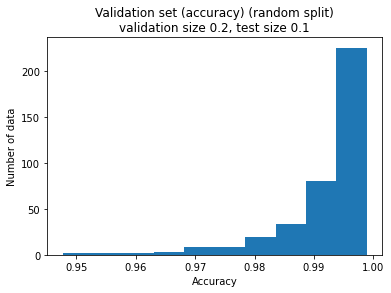

In [117]:
plt.hist(acc_val_list)
plt.title('Validation set (accuracy) (random split)\nvalidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(validation).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

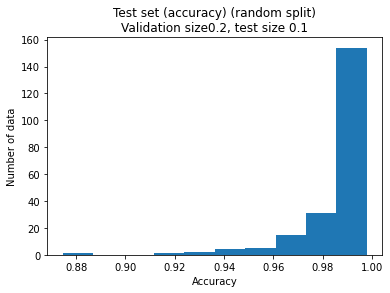

In [118]:
plt.hist(acc_test_list)
plt.title('Test set (accuracy) (random split)\nValidation size0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(test).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

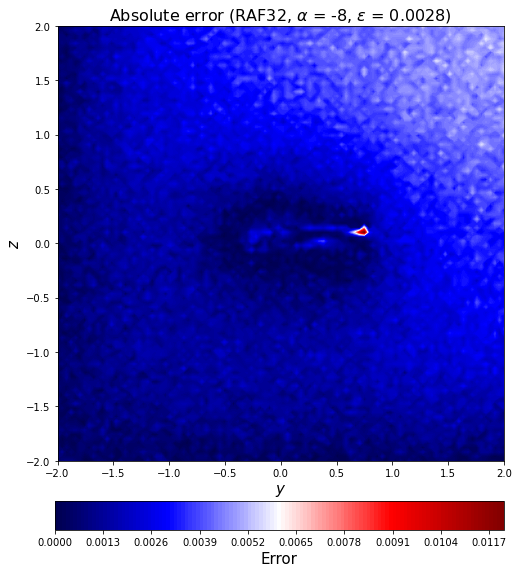

In [99]:
error_test_abs2_rotate = error_test_abs[-1].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-1])[3:-2],
                                                                   aa_test[-1], l2_error_test_list[-1]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-1])[3:-2])+str(aa_test[-1])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

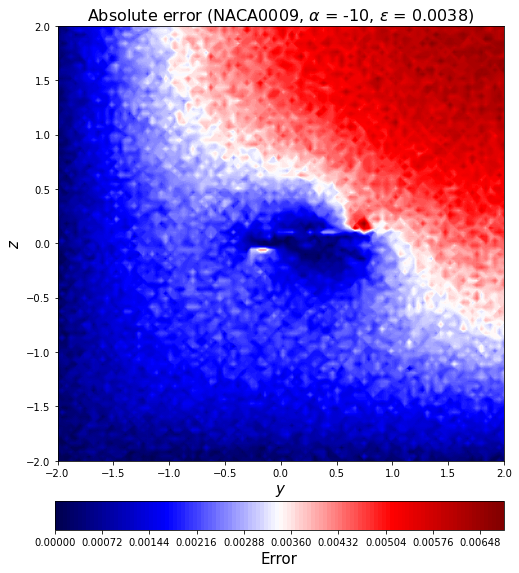

In [100]:
error_test_abs2_rotate = error_test_abs[-2].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-2])[3:-2],
                                                                   aa_test[-2], l2_error_test_list[-2]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-2])[3:-2])+str(aa_test[-2])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

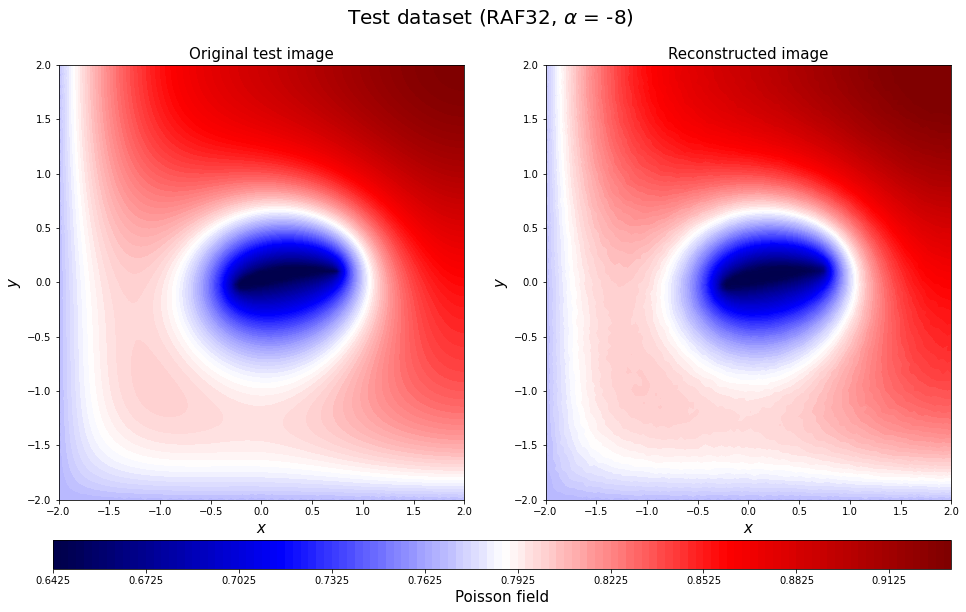

In [101]:
c=-1
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

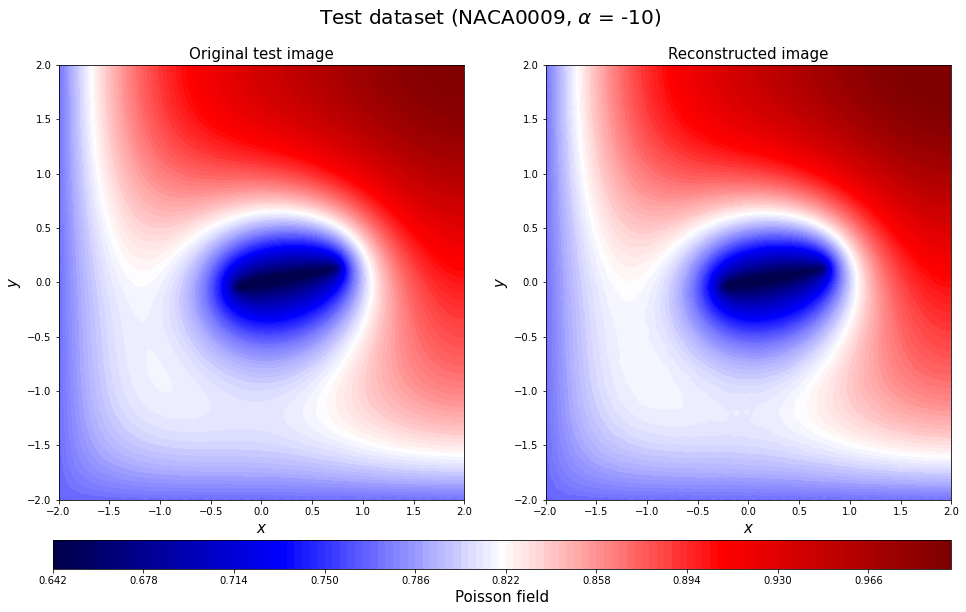

In [102]:
c=-2
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

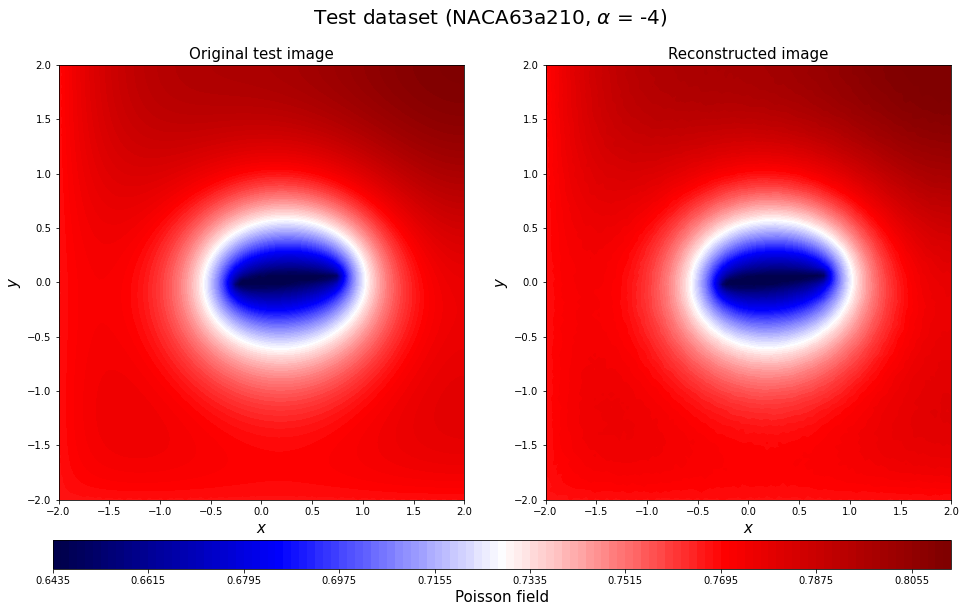

In [103]:
c=-16
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

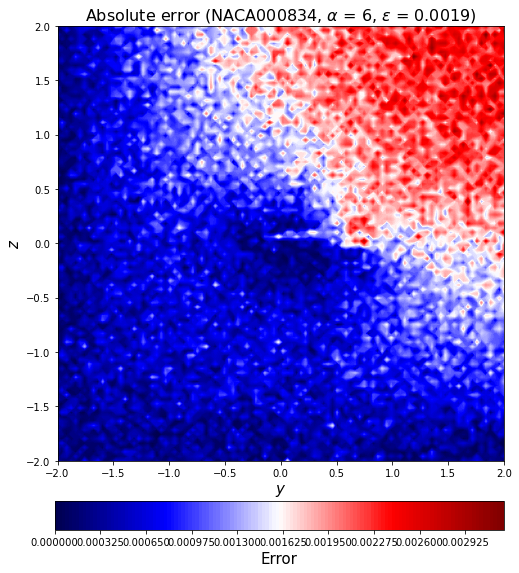

In [104]:
error_test_abs2_rotate = error_test_abs[-15].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-15])[3:-2],
                                                                   aa_test[-15], l2_error_test_list[-15]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-15])[3:-2])+str(aa_test[-15])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

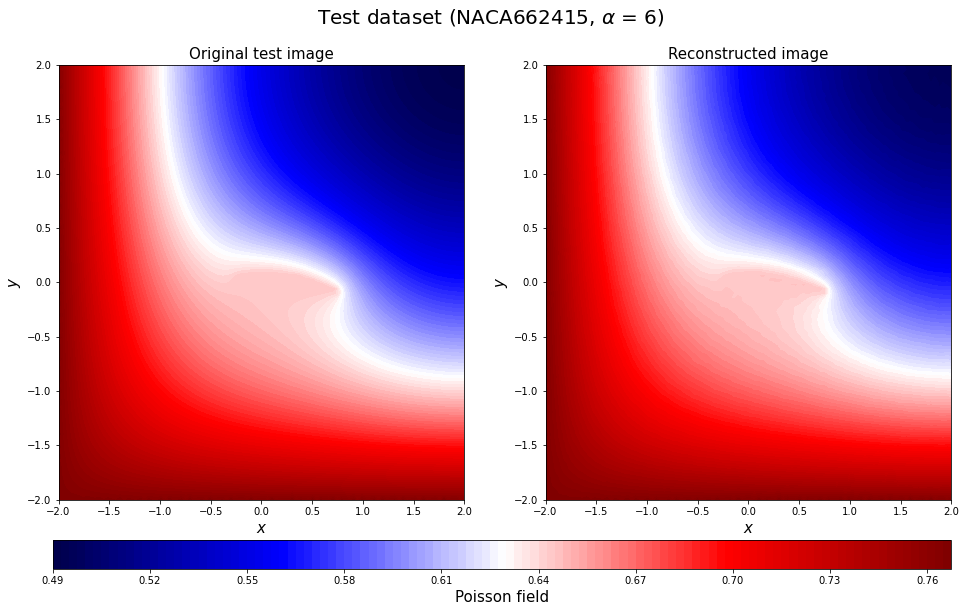

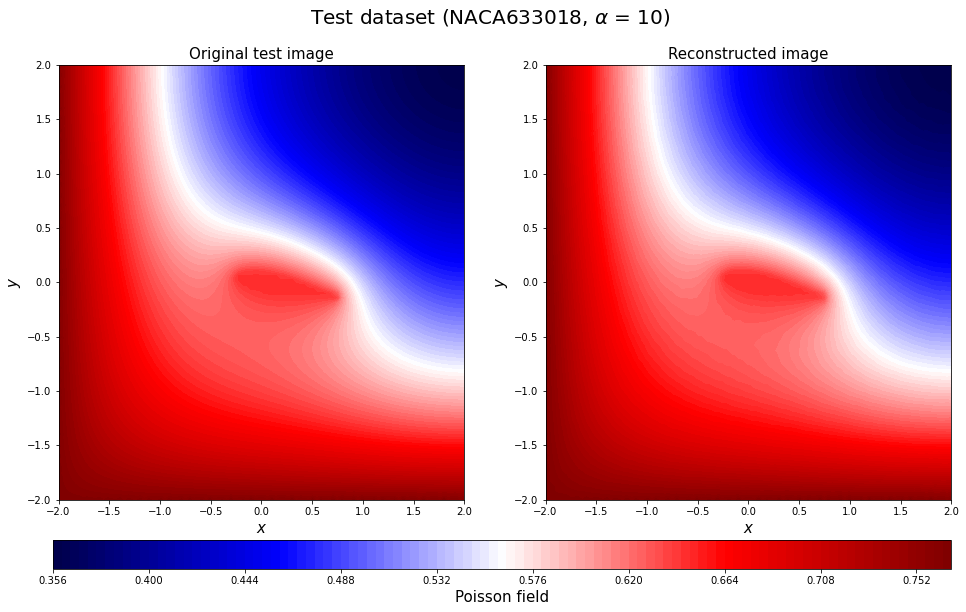

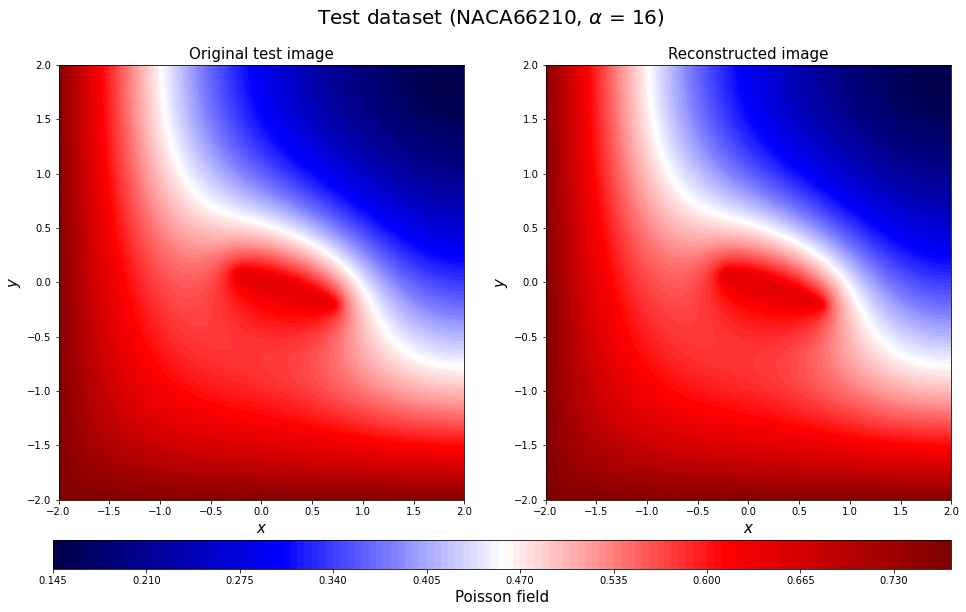

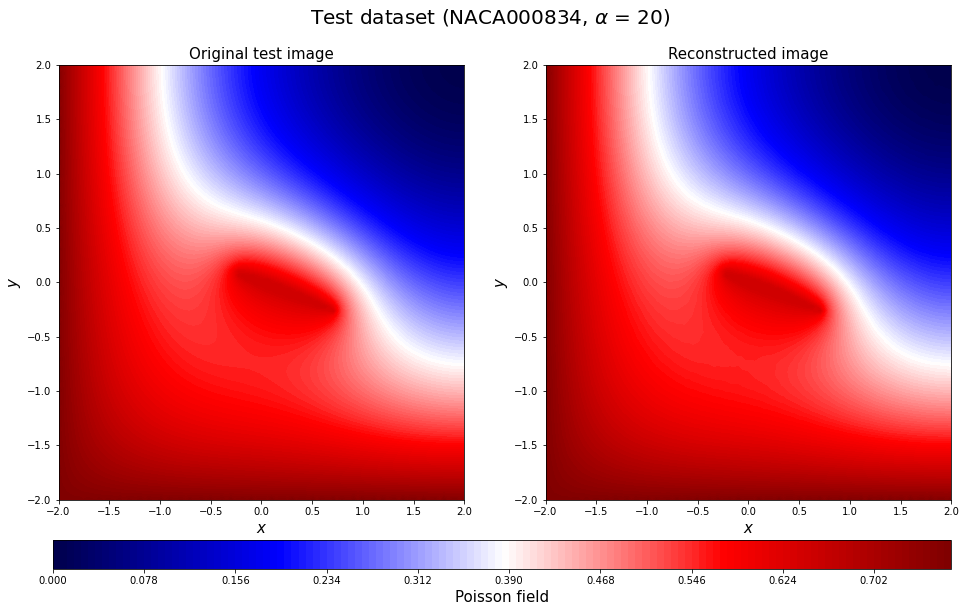

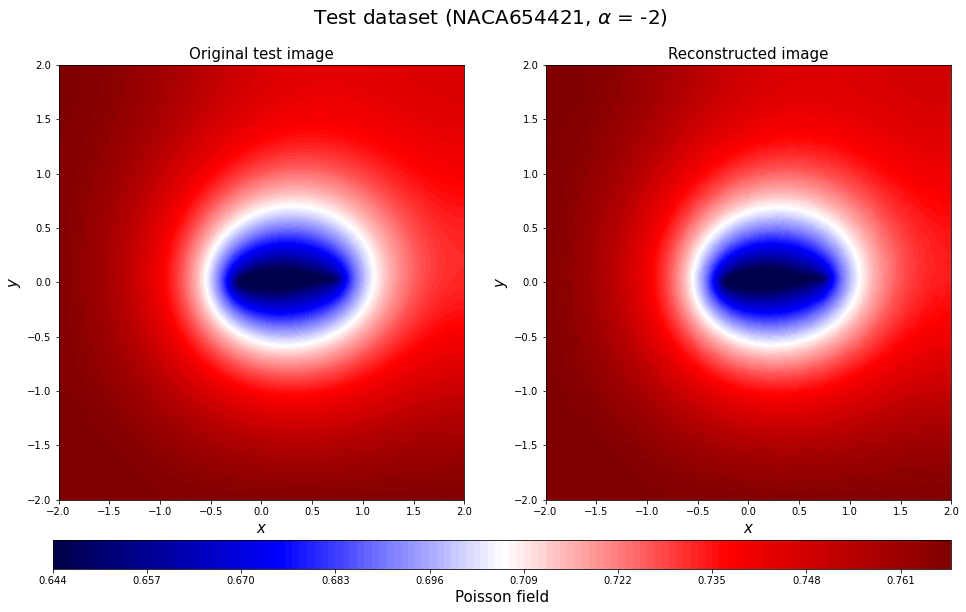

...

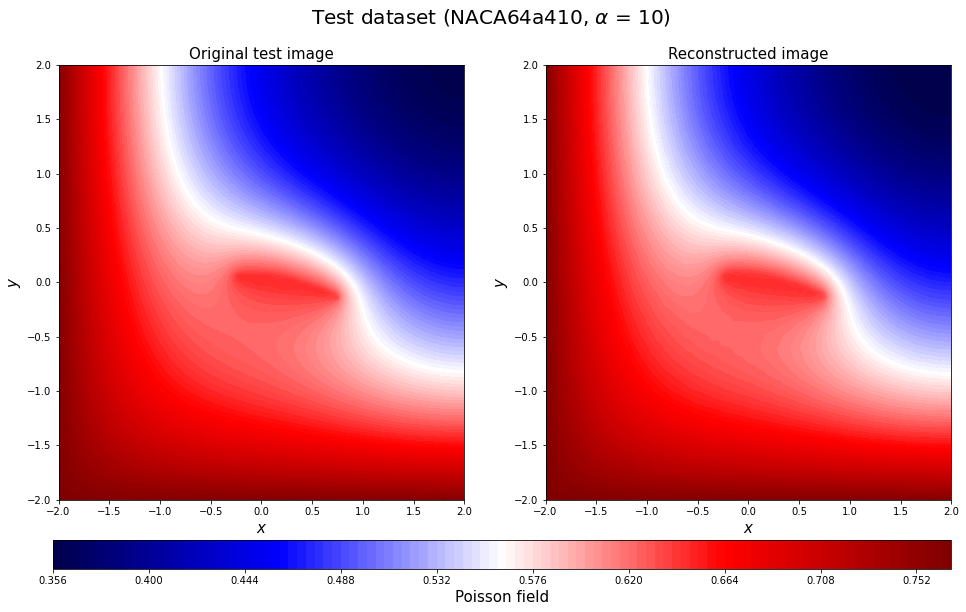

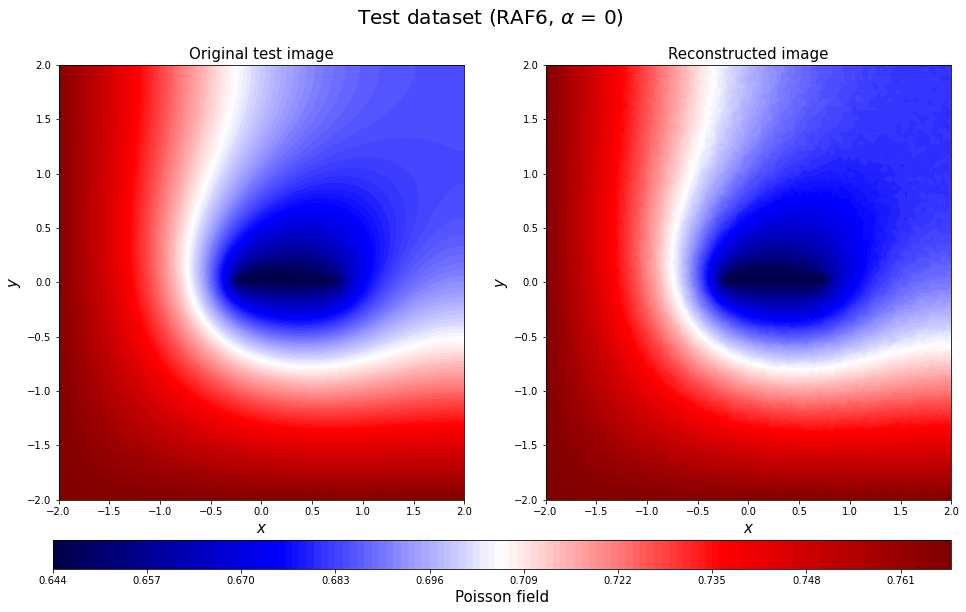

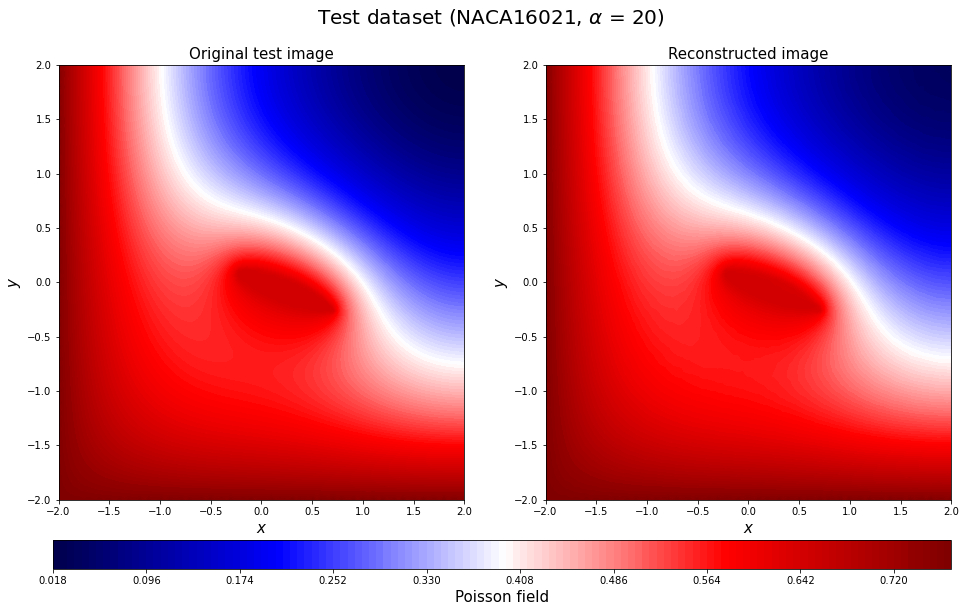

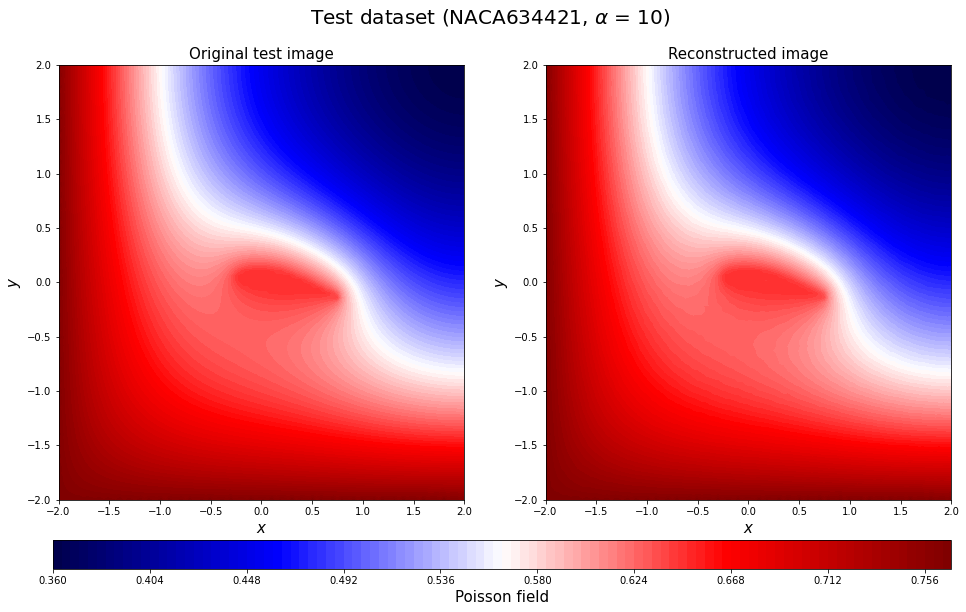

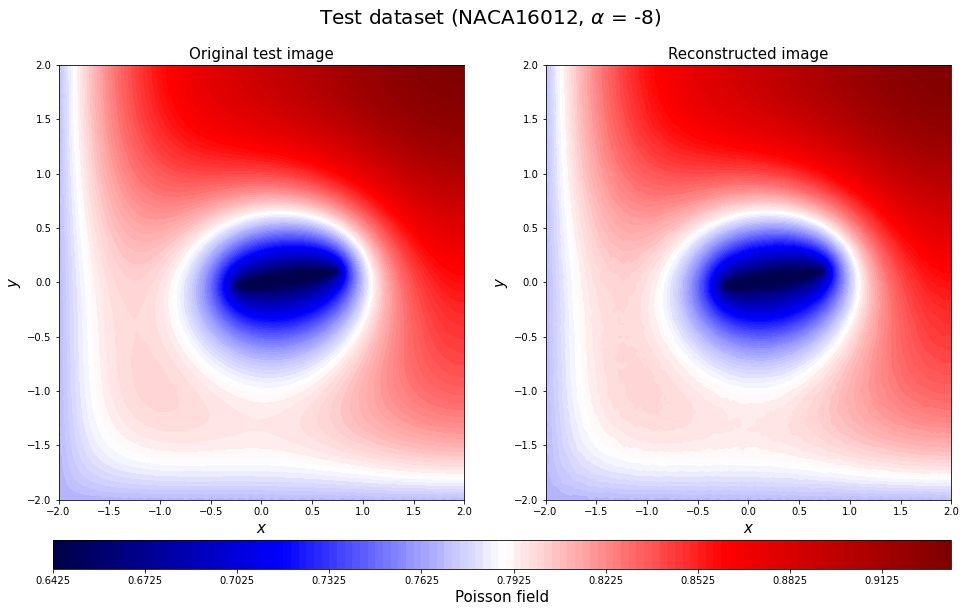

In [105]:
for c in range(96,112):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

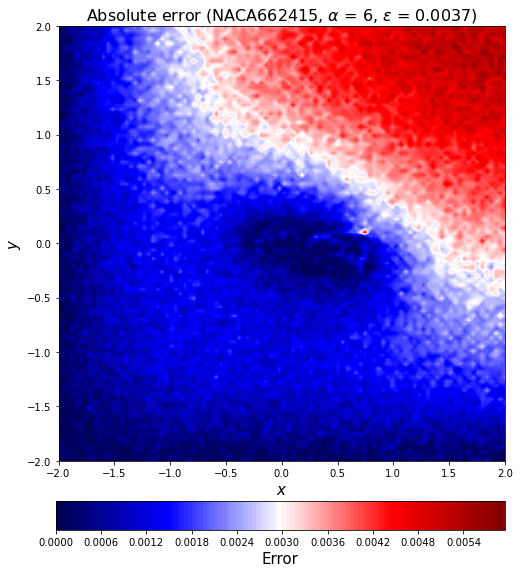

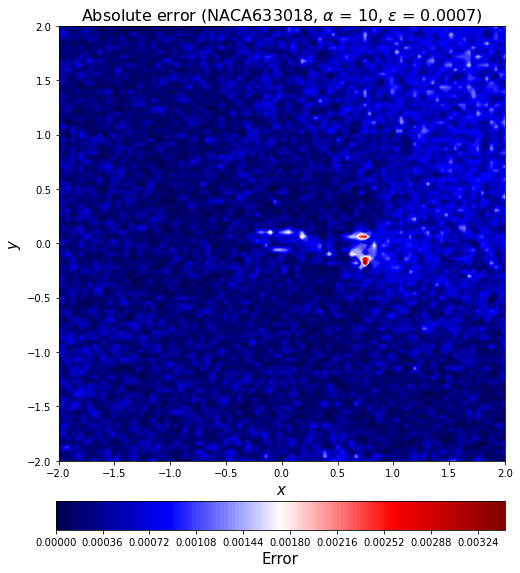

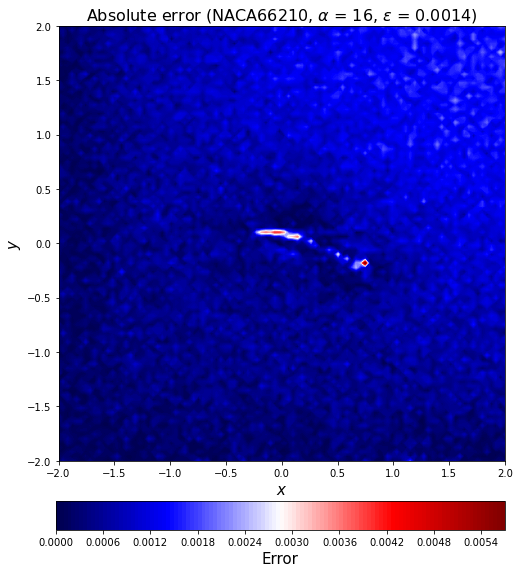

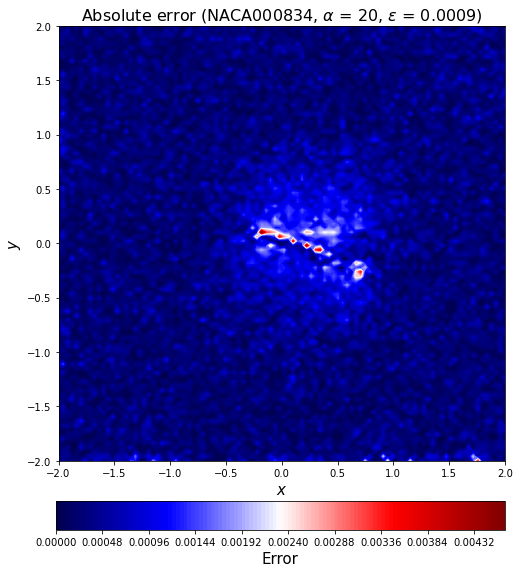

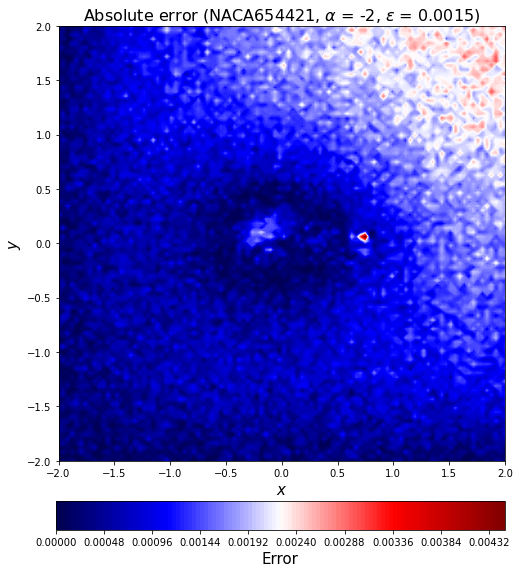

...

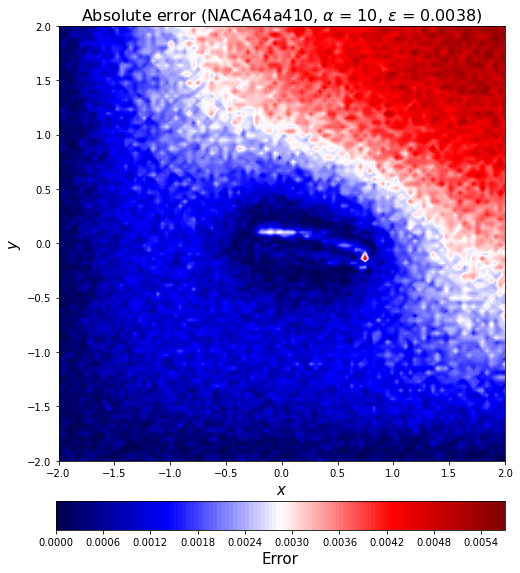

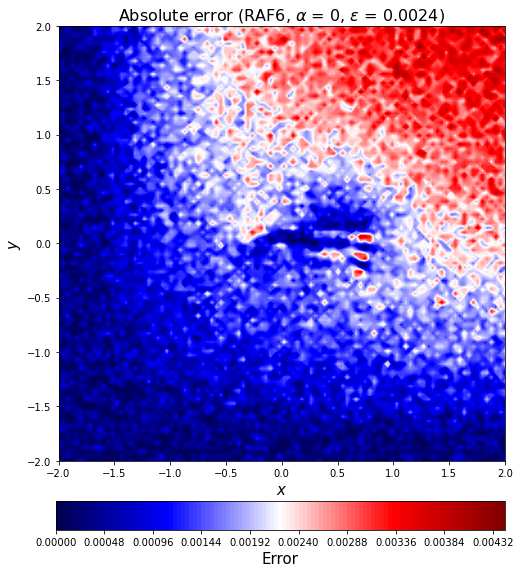

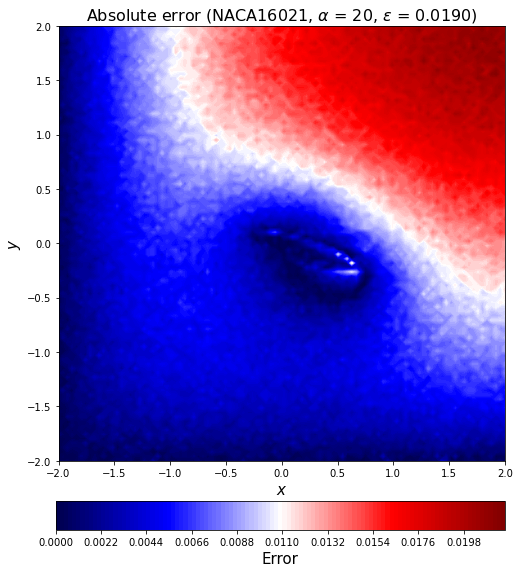

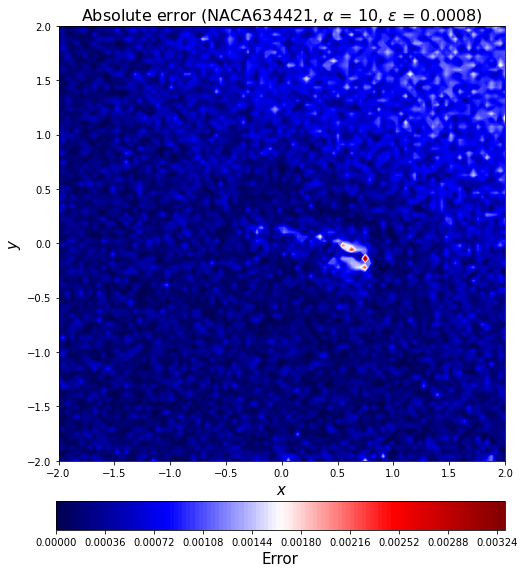

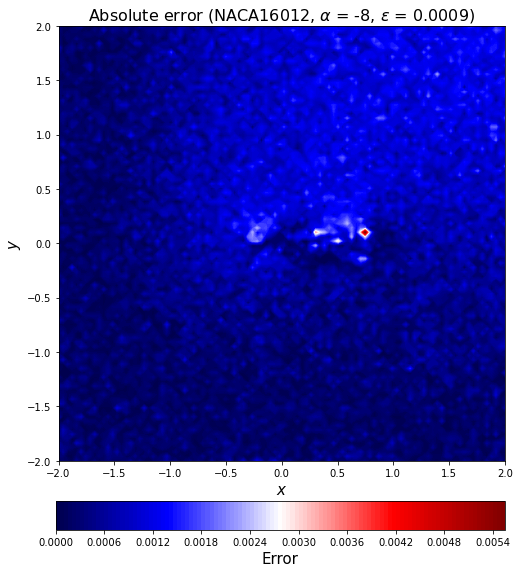

In [106]:
for c in range(96,112):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

In [119]:
from sklearn.metrics import mean_absolute_percentage_error as mape

In [122]:
y_train.shape

(1532, 100, 100)

In [125]:
print(MAPE_train)
acc_train = 1-MAPE_train
print(acc_train)

0.03476277771902913
0.9652372222809709


0.9994475025680677
0.0005524974319323084
0.9982484607874949
0.0017515392125051488
0.9983287753322271
0.0016712246677729192


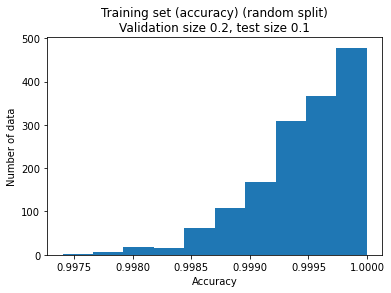

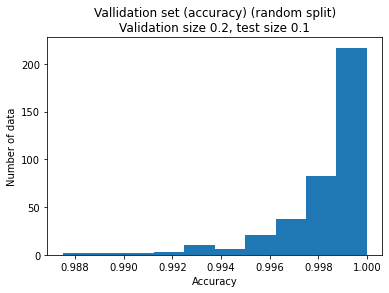

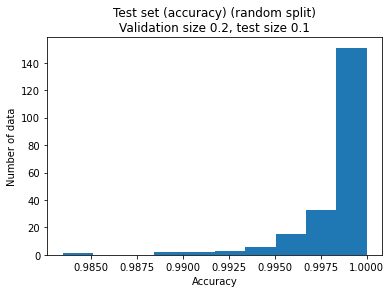

In [147]:
yTrainSum = np.zeros((y_train.shape[0],1))
dTrainSum = np.zeros((decoded_train.shape[0], 1))
MAPE_train_list = np.zeros((y_train.shape[0], 1))
for i in range(0, y_train.shape[0]):
    yTrainSum[i,:] = np.sum(y_train[i])
    dTrainSum[i,:] = np.sum(decoded_train[i])
    MAPE_train_list[i,:] = np.abs((dTrainSum[i,:]-yTrainSum[i,:])/yTrainSum[i,:])
    
MAPE_train =1-np.sum(MAPE_train_list)/x_train.shape[0]
print(MAPE_train)
acc_train = 1-MAPE_train
print(acc_train)
acc_train_list = 1 - MAPE_train_list

yValSum = np.zeros((y_val.shape[0],1))
dValSum = np.zeros((decoded_val.shape[0], 1))
MAPE_val_list = np.zeros((y_val.shape[0], 1))
for i in range(0, y_val.shape[0]):
    yValSum[i,:] = np.sum(y_val[i])
    dValSum[i,:] = np.sum(decoded_val[i])
    MAPE_val_list[i,:] = np.abs((dValSum[i,:]-yValSum[i,:])/yValSum[i,:])
    
MAPE_val = 1-np.sum(MAPE_val_list)/x_val.shape[0]
print(MAPE_val)
acc_val = 1-MAPE_val
print(acc_val)
acc_val_list = 1 - MAPE_val_list

yTestSum = np.zeros((y_test.shape[0],1))
dTestSum = np.zeros((decoded_test.shape[0], 1))
MAPE_test_list = np.zeros((y_test.shape[0], 1))
for i in range(0, y_test.shape[0]):
    yTestSum[i,:] = np.sum(y_test[i])
    dTestSum[i,:] = np.sum(decoded_test[i])
    MAPE_test_list[i,:] = np.abs((dTestSum[i,:]-yTestSum[i,:])/yTestSum[i,:])
    
MAPE_test = 1-np.sum(MAPE_test_list)/x_test.shape[0]
print(MAPE_test)
acc_test = 1-MAPE_test
print(acc_test)
acc_test_list = 1 - MAPE_test_list

plt.hist(acc_train_list)
plt.title('Training set (accuracy) (random split)\nValidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
save_acc_name = "20221030Accuracy_Poisson_bc2(training).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

plt.hist(acc_val_list)
plt.title('Vallidation set (accuracy) (random split)\nValidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(validation).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

plt.hist(acc_test_list)
plt.title('Test set (accuracy) (random split)\nValidation size 0.2, test size 0.1')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(test).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

In [134]:
acc_train=1-MAPE_train
print(acc_train)

0.9447502568067702


In [127]:
y_train_flat = y_train.flatten()
decoded_train_flat = decoded_train.flatten()
mape_p = []
for idx, value in enumerate(y_train_flat):
    up = decoded_train_flat[idx] - value
    down = value
    if down==0:
        mape_p.append(0)
    else:
        mape_p.append(np.abs(up/down))

mape_train = sum(mape_p)/len(mape_p)*100

In [128]:
print(mape_train)

0.08892328980248897
